In [ ]:
#replogle_GSM4367984_concat_identities.csv

#'sgPMVKa_sgFDPSb','sgPMVKa_sgNegCtrl3b', 'sgNegCtrl02093a_sgFDPSb' , 'sgHUS1_2a_sgFDPS_2b','crisprsgHUS1_2a_sgNegCtrl3b','crisprsgNegCtrl02093a_sgFDPS_2b'

#'crisprsgNegCtrl02093a_sgNegCtrl3b','crisprsgNegCtrl4a_sgNegCtrl3b','crisprsgNegCtrl8a_sgNegCtrl3b','crisprsgNegCtrl5a_sgNegCtrl3b','crisprsgNegCtrl1a_sgNegCtrl3b','crisprsgNegCtrl9a_sgNegCtrl3b'



In [3]:
import sys
sys.path.insert(0, '/home/tchari/monod/src/')

In [4]:
import monod
from monod import preprocess, extract_data, cme_toolbox, inference, analysis

In [145]:
import pandas as pd
import numpy as np
import loompy as lp
import matplotlib.pyplot as plt
import scipy
import seaborn as sns
import scipy.stats
import random

from sklearn.ensemble import ExtraTreesClassifier, RandomForestClassifier, ExtraTreesRegressor, RandomForestRegressor
from sklearn.model_selection import train_test_split, ShuffleSplit
from sklearn.metrics import accuracy_score, classification_report

from sklearn.linear_model import LinearRegression, LogisticRegression

In [6]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

In [7]:
meta_path = "/home/tchari/metadata/"
meta = pd.read_csv(meta_path+'replogle_GSM4367984_concat_identities.csv')

#'guide_identity'

In [8]:
meta.head()

,cell_barcode,guide_identity,num_guides,A,B,representation,single,double,essential,control,...,target_A,target_B,umi_A,umi_B,read_count,UMI_count,coverage,good_coverage,number_of_cells,gemgroup
0,AAACCCAAGATCCGAG-5,sgNegCtrl02093a_sgFDPSb,2,sgNegCtrl02093a,sgFDPSb,4.0,1.0,0.0,0.0,0.0,...,Non-Targeting,ENSG00000160752,191,2107,100,100,2,True,1,5
1,AAACCCAAGCATGAAT-3,sgNegCtrl8a_sgNegCtrl3b,2,sgNegCtrl8a,sgNegCtrl3b,2.0,0.0,0.0,0.0,1.0,...,Non-Targeting,Non-Targeting,1053,250,100,100,2,True,1,3
2,AAACCCAAGGCACCAA-3,sgHMGCRa_sgFDPSb,2,sgHMGCRa,sgFDPSb,1.0,0.0,1.0,0.0,0.0,...,ENSG00000113161,ENSG00000160752,2412,1431,100,100,2,True,1,3
3,AAACCCAAGGCATGGT-1,sgHUS1_2a_sgFDPS_2b,2,sgHUS1_2a,sgFDPS_2b,2.0,0.0,1.0,0.0,0.0,...,ENSG00000136273,ENSG00000160752,136,83,100,100,2,True,1,1
4,AAACCCAAGGGTACAC-6,sgHUS1_2a_sgFDPSb,2,sgHUS1_2a,sgFDPSb,2.0,0.0,1.0,0.0,0.0,...,ENSG00000136273,ENSG00000160752,45,48,100,100,2,True,1,6


In [9]:
dataset_meta = ['allcrispr']
print('dataset_meta: ', dataset_meta)
print()

subcluster_names = [['sgPMVKa_sgFDPSb'],['sgPMVKa_sgNegCtrl3b'],['sgNegCtrl02093a_sgFDPSb'],
					['sgHUS1_2a_sgFDPS_2b'],['sgHUS1_2a_sgNegCtrl3b'],['sgNegCtrl02093a_sgFDPS_2b'],
					['sgNegCtrl02093a_sgNegCtrl3b'],
					['sgNegCtrl4a_sgNegCtrl3b'],['sgNegCtrl8a_sgNegCtrl3b'],
					['sgNegCtrl5a_sgNegCtrl3b'],['sgNegCtrl1a_sgNegCtrl3b'],
					['sgNegCtrl9a_sgNegCtrl3b'],['sgNegCtrl4a_sgNegCtrl3b','sgNegCtrl8a_sgNegCtrl3b',
					'sgNegCtrl5a_sgNegCtrl3b','sgNegCtrl1a_sgNegCtrl3b','sgNegCtrl9a_sgNegCtrl3b']]

sub_names_only = ['_'.join(n) for n in subcluster_names]

cluster_names = []
dataset_names = ['replogle_'+dataset_meta[0]+'_'+y  for y in sub_names_only]   #To save
print('dataset_names: ', dataset_names)
print('len(dataset_names): ',len(dataset_names))
print()

raw_data_locations = [dataset_meta[0] for y in sub_names_only]
transcriptome_filepath = '/home/tchari/perturbCME/notebooks/gg_200525_genome_polyA_cum_3'

spliced_layer = 'spliced'
unspliced_layer = 'unspliced'
gene_attr = 'gene_name'
cell_attr = 'barcode'

attribute_names=[(unspliced_layer,spliced_layer),gene_attr,cell_attr]

loom_filepaths = ['/home/tchari/counts/replogle_crispr/loom/'+x+'.loom' for x in raw_data_locations] 
print('loom_filepaths: ',loom_filepaths)

n_datasets = len(loom_filepaths)

dataset_meta:  ['allcrispr']

dataset_names:  ['replogle_allcrispr_sgPMVKa_sgFDPSb', 'replogle_allcrispr_sgPMVKa_sgNegCtrl3b', 'replogle_allcrispr_sgNegCtrl02093a_sgFDPSb', 'replogle_allcrispr_sgHUS1_2a_sgFDPS_2b', 'replogle_allcrispr_sgHUS1_2a_sgNegCtrl3b', 'replogle_allcrispr_sgNegCtrl02093a_sgFDPS_2b', 'replogle_allcrispr_sgNegCtrl02093a_sgNegCtrl3b', 'replogle_allcrispr_sgNegCtrl4a_sgNegCtrl3b', 'replogle_allcrispr_sgNegCtrl8a_sgNegCtrl3b', 'replogle_allcrispr_sgNegCtrl5a_sgNegCtrl3b', 'replogle_allcrispr_sgNegCtrl1a_sgNegCtrl3b', 'replogle_allcrispr_sgNegCtrl9a_sgNegCtrl3b', 'replogle_allcrispr_sgNegCtrl4a_sgNegCtrl3b_sgNegCtrl8a_sgNegCtrl3b_sgNegCtrl5a_sgNegCtrl3b_sgNegCtrl1a_sgNegCtrl3b_sgNegCtrl9a_sgNegCtrl3b']
len(dataset_names):  13

loom_filepaths:  ['/home/tchari/counts/replogle_crispr/loom/allcrispr.loom', '/home/tchari/counts/replogle_crispr/loom/allcrispr.loom', '/home/tchari/counts/replogle_crispr/loom/allcrispr.loom', '/home/tchari/counts/replogle_crispr/loom/allcrispr

Dataset allcrispr. 
	9565 barcodes in loom, 7507 pass filter. AAACCCAAGATCCGAG-5AAACCCAAGCATGAAT-3AAACCCAAGGCACCAA-3AAACCCAAGGCATGGT-1AAACCCAAGGGTACAC-6AAACCCAAGTCTCCTC-6AAACCCAAGTGTAGAT-5AAACCCAAGTGTTCAC-1AAACCCAAGTTGGAAT-3AAACCCACACATATCG-2AAACCCACACGTAGAG-3AAACCCACAGACAAGC-5AAACCCACAGGACATG-6AAACCCAGTAACCCGC-2AAACCCAGTAAGGAGA-6AAACCCAGTACCACGC-3AAACCCAGTCACGACC-1AAACCCAGTCAGCTTA-1AAACCCAGTCATAGTC-4AAACCCAGTCGAGATG-2AAACCCAGTGATTCAC-3AAACCCAGTGCTTATG-1AAACCCAGTTGCCGAC-4AAACCCATCATGGTAC-4AAACCCATCGCGGTAC-5AAACCCATCGGCATTA-5AAACCCATCGGTAAGG-6AAACCCATCGGTCGGT-5AAACCCATCTTAAGGC-6AAACCCATCTTGTTAC-5AAACGAAAGACTCTAC-1AAACGAAAGATACGAT-6AAACGAAAGATGACAT-2AAACGAAAGCACCAGA-4AAACGAAAGCGACCCT-6AAACGAAAGCGGTAAC-2AAACGAAAGGATACGC-1AAACGAAAGTAGAGTT-2AAACGAAAGTATAGGT-6AAACGAACAAACACGG-5AAACGAACAAATGATG-4AAACGAACAACGGCCT-5AAACGAACACCAATTG-2AAACGAACACCCTGTT-1AAACGAACACCTCGTT-6AAACGAACAGCTAACT-6AAACGAACAGCTGTTA-5AAACGAACAGGCTATT-3AAACGAACATGGCCAC-2AAACGAAGTACAATAG-6AAACGAAGTAGCCCTG-3AAACGAAGTAGCTGAG-4AA

	['sgPMVKa_sgNegCtrl3b']: 389 cells in annotations. 389 in loom. 318 pass filter.
	['sgNegCtrl02093a_sgFDPSb']: 1921 cells in annotations. 1921 in loom. 1544 pass filter.
	['sgHUS1_2a_sgFDPS_2b']: 831 cells in annotations. 831 in loom. 525 pass filter.
	['sgHUS1_2a_sgNegCtrl3b']: 905 cells in annotations. 905 in loom. 761 pass filter.
	['sgNegCtrl02093a_sgFDPS_2b']: 439 cells in annotations. 439 in loom. 316 pass filter.
	['sgNegCtrl02093a_sgNegCtrl3b']: 1465 cells in annotations. 1465 in loom. 1170 pass filter.
	['sgNegCtrl4a_sgNegCtrl3b']: 780 cells in annotations. 780 in loom. 622 pass filter.
	['sgNegCtrl8a_sgNegCtrl3b']: 592 cells in annotations. 592 in loom. 471 pass filter.
	['sgNegCtrl5a_sgNegCtrl3b']: 577 cells in annotations. 577 in loom. 457 pass filter.
	['sgNegCtrl1a_sgNegCtrl3b']: 576 cells in annotations. 576 in loom. 464 pass filter.
	['sgNegCtrl9a_sgNegCtrl3b']: 573 cells in annotations. 573 in loom. 444 pass filter.
	['sgNegCtrl4a_sgNegCtrl3b', 'sgNegCtrl8a_sgNegCtrl3

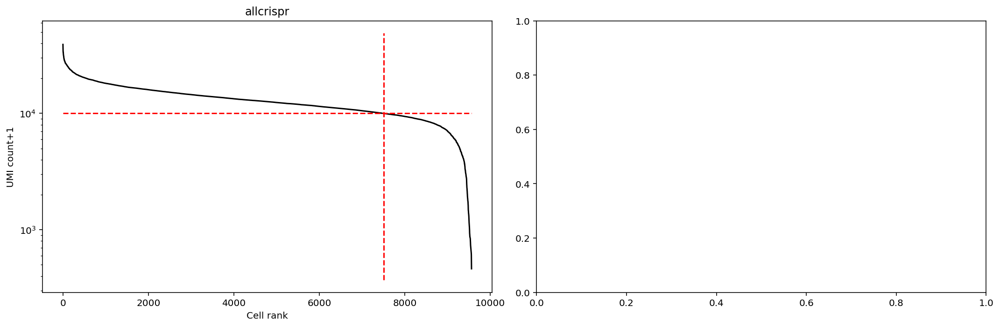

In [10]:
cf = []
thr_lb = [1e4]*len(dataset_meta)*2

fig1,ax1 = plt.subplots(1,len(dataset_meta)*2,figsize=(15,5))

for k in range(len(dataset_meta)):
    filename = loom_filepaths[len(subcluster_names)*k]
    dataset_name = raw_data_locations[len(subcluster_names)*k]
    
    with lp.connect(filename,mode='r') as ds:
        S = ds.layers[spliced_layer][:]
        U = ds.layers[unspliced_layer][:]
        gene_names = ds.ra[gene_attr]
        bcs = ds.ca[cell_attr]
        n_cells = S.shape[1]
        monod.preprocess.knee_plot(S+U,ax1[k],viz=True,thr=thr_lb[k])
        cf_ = ((S+U).sum(0)>thr_lb[k])
        
        n_annot_bcs = meta['cell_barcode'].sum()
        annot_bcs_in_loom = meta['cell_barcode'].isin(bcs).sum()
        annot_bcs_in_filt_loom = meta['cell_barcode'].isin(bcs[cf_]).sum()
        print(f'Dataset {dataset_name}. \n\t{len(bcs)} barcodes in loom, {cf_.sum()} pass filter. {n_annot_bcs} in annotations; of these, {annot_bcs_in_loom} in loom and {annot_bcs_in_filt_loom} in filtered loom.')
        
        #if k==0:
        for subcluster in subcluster_names:
            annot_bcs = meta[(meta['guide_identity'].isin(subcluster))]['cell_barcode']
            cf.append(np.isin(bcs,annot_bcs) & cf_)
            print(f'\t{subcluster}: {len(annot_bcs)} cells in annotations. {np.isin(bcs,annot_bcs).sum()} in loom. {cf[-1].sum()} pass filter.')



    ax1[k].set_title(dataset_name)
    
!mkdir ./figs    
fig_dir = './figs/'
fig_string = fig_dir + 'kneeplots_all_replogle.png'
fig1.tight_layout()
plt.savefig(fig_string,dpi=450)

In [11]:
print("Cells per subcluster: ", [x.sum() for x in cf])

Cells per subcluster:  [415, 318, 1544, 525, 761, 316, 1170, 622, 471, 457, 464, 444, 2458]


## **Gene Filtering**

In [12]:
import logging, sys
logging.basicConfig(stream=sys.stdout)
log = logging.getLogger()
log.setLevel(logging.INFO)

In [9]:
!mkdir ./fits

mkdir: cannot create directory ‘./fits’: File exists


In [ ]:
dir_string,dataset_strings = monod.preprocess.construct_batch(loom_filepaths, \
                                             transcriptome_filepath, \
                                             dataset_names, \
                                             attribute_names=attribute_names,\
                                             batch_location='./fits',meta='replogle_crispr',batch_id=1,\
                                             n_genes=3000,exp_filter_threshold=None,cf=cf) #maybe viz=False

In [13]:
dir_string = './fits/gg_230208_026_replogle_crispr_1'

In [14]:
dataset_strings = ['./fits/gg_230208_026_replogle_crispr_1/replogle_allcrispr_sgPMVKa_sgFDPSb', 
                   './fits/gg_230208_026_replogle_crispr_1/replogle_allcrispr_sgPMVKa_sgNegCtrl3b', 
                   './fits/gg_230208_026_replogle_crispr_1/replogle_allcrispr_sgNegCtrl02093a_sgFDPSb', 
                   './fits/gg_230208_026_replogle_crispr_1/replogle_allcrispr_sgHUS1_2a_sgFDPS_2b', 
                   './fits/gg_230208_026_replogle_crispr_1/replogle_allcrispr_sgHUS1_2a_sgNegCtrl3b', 
                   './fits/gg_230208_026_replogle_crispr_1/replogle_allcrispr_sgNegCtrl02093a_sgFDPS_2b', 
                   './fits/gg_230208_026_replogle_crispr_1/replogle_allcrispr_sgNegCtrl02093a_sgNegCtrl3b', 
                   './fits/gg_230208_026_replogle_crispr_1/replogle_allcrispr_sgNegCtrl4a_sgNegCtrl3b', 
                   './fits/gg_230208_026_replogle_crispr_1/replogle_allcrispr_sgNegCtrl8a_sgNegCtrl3b', 
                   './fits/gg_230208_026_replogle_crispr_1/replogle_allcrispr_sgNegCtrl5a_sgNegCtrl3b', 
                   './fits/gg_230208_026_replogle_crispr_1/replogle_allcrispr_sgNegCtrl1a_sgNegCtrl3b', 
                   './fits/gg_230208_026_replogle_crispr_1/replogle_allcrispr_sgNegCtrl9a_sgNegCtrl3b', 
                   './fits/gg_230208_026_replogle_crispr_1/replogle_allcrispr_sgNegCtrl4a_sgNegCtrl3b_sgNegCtrl8a_sgNegCtrl3b_sgNegCtrl5a_sgNegCtrl3b_sgNegCtrl1a_sgNegCtrl3b_sgNegCtrl9a_sgNegCtrl3b']



## **Inference**

In [15]:
#Define bounds
phys_lb = [-2.0, -1.8, -1.8 ] #-1.0, -1.8, -1.8
phys_ub = [4.2, 2.5, 2.5] #4.2, 2.5, 3.5
samp_lb = [-9, -4] #-7.5, -2
samp_ub = [-4, 1.5] #-5.5, 0
# gridsize = [5,6]
gridsize = [20,21]


In [ ]:
result_strings = []
for i in range(n_datasets):
    fitmodel = monod.cme_toolbox.CMEModel('Bursty','Poisson')
    inference_parameters = monod.inference.InferenceParameters(phys_lb,phys_ub,samp_lb,samp_ub,gridsize,\
                dataset_strings[i],fitmodel,use_lengths = True,
                gradient_params = {'max_iterations':20,'init_pattern':'moments','num_restarts':5})
    search_data = monod.extract_data.extract_data(loom_filepaths[i], transcriptome_filepath, dataset_names[i],
                dataset_strings[i], dir_string, dataset_attr_names=attribute_names,cf=cf[i])
    full_result_string = inference_parameters.fit_all_grid_points(60,search_data)

    result_strings.append(full_result_string)

In [16]:
#All result files
result_strings = ['./fits/gg_230208_026_replogle_crispr_1/replogle_allcrispr_sgPMVKa_sgFDPSb/Bursty_Poisson_20x21/grid_scan_results.res', 
                  './fits/gg_230208_026_replogle_crispr_1/replogle_allcrispr_sgPMVKa_sgNegCtrl3b/Bursty_Poisson_20x21/grid_scan_results.res', 
                  './fits/gg_230208_026_replogle_crispr_1/replogle_allcrispr_sgNegCtrl02093a_sgFDPSb/Bursty_Poisson_20x21/grid_scan_results.res', 
                  './fits/gg_230208_026_replogle_crispr_1/replogle_allcrispr_sgHUS1_2a_sgFDPS_2b/Bursty_Poisson_20x21/grid_scan_results.res', 
                  './fits/gg_230208_026_replogle_crispr_1/replogle_allcrispr_sgHUS1_2a_sgNegCtrl3b/Bursty_Poisson_20x21/grid_scan_results.res', 
                  './fits/gg_230208_026_replogle_crispr_1/replogle_allcrispr_sgNegCtrl02093a_sgFDPS_2b/Bursty_Poisson_20x21/grid_scan_results.res', 
                  './fits/gg_230208_026_replogle_crispr_1/replogle_allcrispr_sgNegCtrl02093a_sgNegCtrl3b/Bursty_Poisson_20x21/grid_scan_results.res', 
                  './fits/gg_230208_026_replogle_crispr_1/replogle_allcrispr_sgNegCtrl4a_sgNegCtrl3b/Bursty_Poisson_20x21/grid_scan_results.res', 
                  './fits/gg_230208_026_replogle_crispr_1/replogle_allcrispr_sgNegCtrl8a_sgNegCtrl3b/Bursty_Poisson_20x21/grid_scan_results.res', 
                  './fits/gg_230208_026_replogle_crispr_1/replogle_allcrispr_sgNegCtrl5a_sgNegCtrl3b/Bursty_Poisson_20x21/grid_scan_results.res', 
                  './fits/gg_230208_026_replogle_crispr_1/replogle_allcrispr_sgNegCtrl1a_sgNegCtrl3b/Bursty_Poisson_20x21/grid_scan_results.res', 
                  './fits/gg_230208_026_replogle_crispr_1/replogle_allcrispr_sgNegCtrl9a_sgNegCtrl3b/Bursty_Poisson_20x21/grid_scan_results.res', 
                  './fits/gg_230208_026_replogle_crispr_1/replogle_allcrispr_sgNegCtrl4a_sgNegCtrl3b_sgNegCtrl8a_sgNegCtrl3b_sgNegCtrl5a_sgNegCtrl3b_sgNegCtrl1a_sgNegCtrl3b_sgNegCtrl9a_sgNegCtrl3b/Bursty_Poisson_20x21/grid_scan_results.res']


## **QC and Analysis of Results**

In [17]:
dir_string = '/home/tchari/perturbCME/notebooks/fits/gg_230208_026_replogle_crispr_1' 


In [ ]:
#Currently showing results for old run
for i in range(n_datasets):
    sr = monod.analysis.load_search_results(result_strings[i])
    sd = monod.analysis.load_search_data(dir_string+'/'+dataset_names[i]+'/raw.sd')
    fig1,ax1 = plt.subplots(1,1)
    sr.find_sampling_optimum()
    sr.plot_landscape(ax1)

    fig1,ax1 = plt.subplots(1,1)
    sr.plot_KL(ax1)

    sr.plot_gene_distributions(sd,marg='joint')

    _=sr.chisquare_testing(sd,threshold=1e-3)
    sr.resample_opt_viz()
    sr.resample_opt_mc_viz()
    sr.chisq_best_param_correction(sd,Ntries=4,viz=False,threshold=1e-3) 

    sr.compute_sigma(sd,num_cores=60)
    sr.plot_param_L_dep(plot_errorbars=False,plot_fit=True)
    sr.plot_param_marg()
    
    monod.analysis.make_batch_analysis_dir([sr],dir_string)
    sr.update_on_disk()
    

In [18]:
#Read back in data
sr_arr = [monod.analysis.load_search_results(r[:-4]+'_upd.res') for r in result_strings]

INFO:root:Grid scan results loaded from ./fits/gg_230208_026_replogle_crispr_1/replogle_allcrispr_sgPMVKa_sgFDPSb/Bursty_Poisson_20x21/grid_scan_results_upd.res.
INFO:root:Grid scan results loaded from ./fits/gg_230208_026_replogle_crispr_1/replogle_allcrispr_sgPMVKa_sgNegCtrl3b/Bursty_Poisson_20x21/grid_scan_results_upd.res.
INFO:root:Grid scan results loaded from ./fits/gg_230208_026_replogle_crispr_1/replogle_allcrispr_sgNegCtrl02093a_sgFDPSb/Bursty_Poisson_20x21/grid_scan_results_upd.res.
INFO:root:Grid scan results loaded from ./fits/gg_230208_026_replogle_crispr_1/replogle_allcrispr_sgHUS1_2a_sgFDPS_2b/Bursty_Poisson_20x21/grid_scan_results_upd.res.
INFO:root:Grid scan results loaded from ./fits/gg_230208_026_replogle_crispr_1/replogle_allcrispr_sgHUS1_2a_sgNegCtrl3b/Bursty_Poisson_20x21/grid_scan_results_upd.res.
INFO:root:Grid scan results loaded from ./fits/gg_230208_026_replogle_crispr_1/replogle_allcrispr_sgNegCtrl02093a_sgFDPS_2b/Bursty_Poisson_20x21/grid_scan_results_upd.r

In [19]:
for i in range(len(sr_arr)):
    sr = sr_arr[i]
    print(str(i)+': '+str(sr.samp_optimum))

0: (-6.368421052631579, -1.25)
1: (-7.157894736842105, -0.9749999999999996)
2: (-7.157894736842105, -1.25)
3: (-6.894736842105264, -0.9749999999999996)
4: (-7.157894736842105, -1.25)
5: (-6.894736842105264, -1.25)
6: (-6.894736842105264, -0.9749999999999996)
7: (-6.894736842105264, -0.9749999999999996)
8: (-6.368421052631579, -0.9749999999999996)
9: (-7.157894736842105, -1.525)
10: (-7.157894736842105, -0.9749999999999996)
11: (-7.684210526315789, -1.525)
12: (-7.684210526315789, -1.7999999999999998)


In [20]:
for i in range(len(dataset_names)):
    print(str(i)+': '+dataset_names[i])

0: replogle_allcrispr_sgPMVKa_sgFDPSb
1: replogle_allcrispr_sgPMVKa_sgNegCtrl3b
2: replogle_allcrispr_sgNegCtrl02093a_sgFDPSb
3: replogle_allcrispr_sgHUS1_2a_sgFDPS_2b
4: replogle_allcrispr_sgHUS1_2a_sgNegCtrl3b
5: replogle_allcrispr_sgNegCtrl02093a_sgFDPS_2b
6: replogle_allcrispr_sgNegCtrl02093a_sgNegCtrl3b
7: replogle_allcrispr_sgNegCtrl4a_sgNegCtrl3b
8: replogle_allcrispr_sgNegCtrl8a_sgNegCtrl3b
9: replogle_allcrispr_sgNegCtrl5a_sgNegCtrl3b
10: replogle_allcrispr_sgNegCtrl1a_sgNegCtrl3b
11: replogle_allcrispr_sgNegCtrl9a_sgNegCtrl3b
12: replogle_allcrispr_sgNegCtrl4a_sgNegCtrl3b_sgNegCtrl8a_sgNegCtrl3b_sgNegCtrl5a_sgNegCtrl3b_sgNegCtrl1a_sgNegCtrl3b_sgNegCtrl9a_sgNegCtrl3b


(-6.368421052631579, -1.25)
INFO:root:Figure stored to ./fits/gg_230208_026_replogle_crispr_1/replogle_allcrispr_sgPMVKa_sgFDPSb/Bursty_Poisson_20x21/analysis_figures/length_dependence.png.
(-7.157894736842105, -0.9749999999999996)
INFO:root:Figure stored to ./fits/gg_230208_026_replogle_crispr_1/replogle_allcrispr_sgPMVKa_sgNegCtrl3b/Bursty_Poisson_20x21/analysis_figures/length_dependence.png.
(-7.157894736842105, -1.25)
INFO:root:Figure stored to ./fits/gg_230208_026_replogle_crispr_1/replogle_allcrispr_sgNegCtrl02093a_sgFDPSb/Bursty_Poisson_20x21/analysis_figures/length_dependence.png.
(-6.894736842105264, -0.9749999999999996)
INFO:root:Figure stored to ./fits/gg_230208_026_replogle_crispr_1/replogle_allcrispr_sgHUS1_2a_sgFDPS_2b/Bursty_Poisson_20x21/analysis_figures/length_dependence.png.
(-7.157894736842105, -1.25)
INFO:root:Figure stored to ./fits/gg_230208_026_replogle_crispr_1/replogle_allcrispr_sgHUS1_2a_sgNegCtrl3b/Bursty_Poisson_20x21/analysis_figures/length_dependence.png.


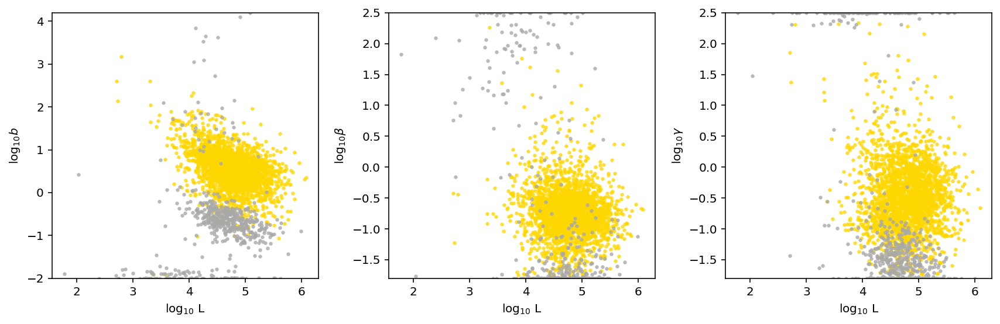

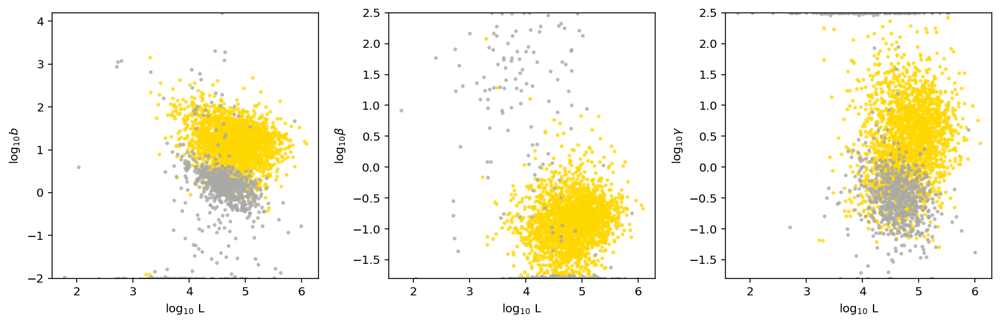

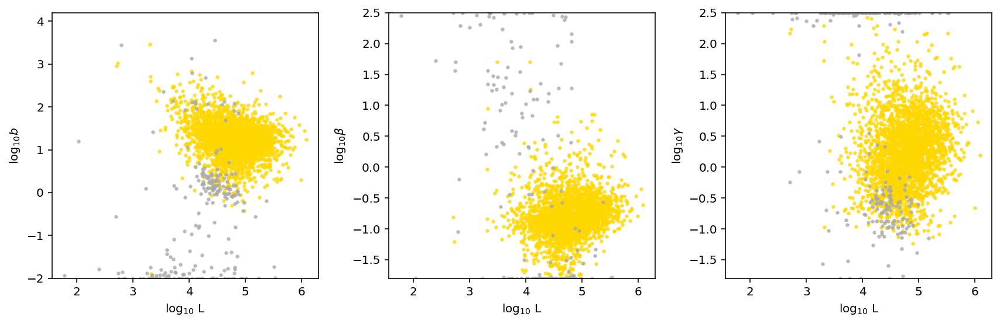

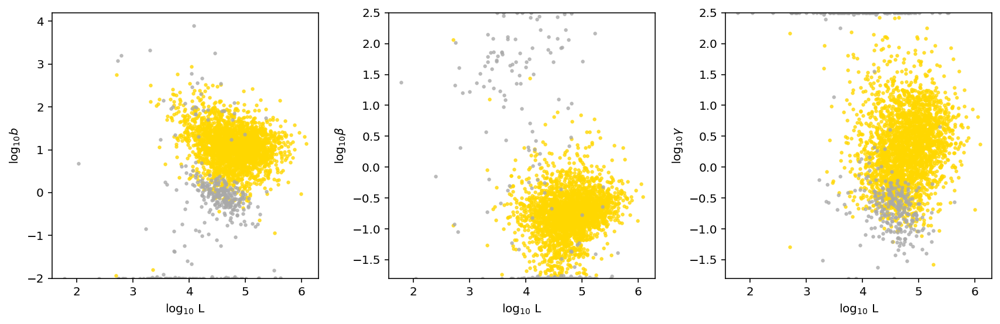

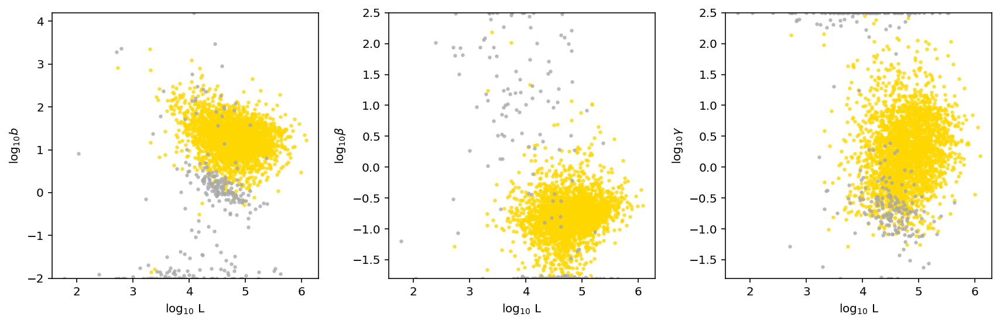

...

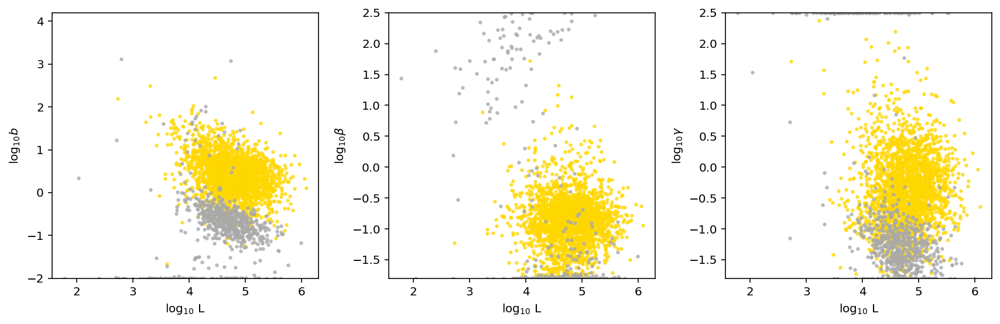

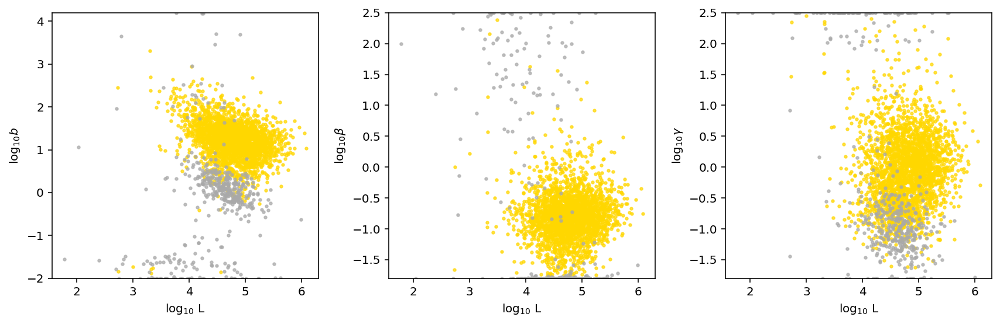

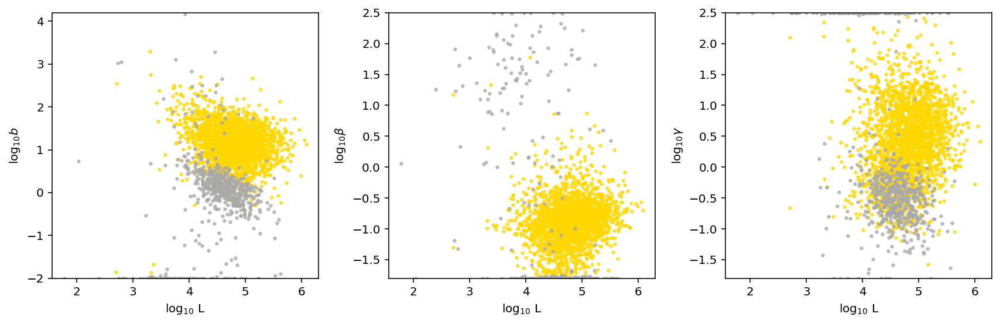

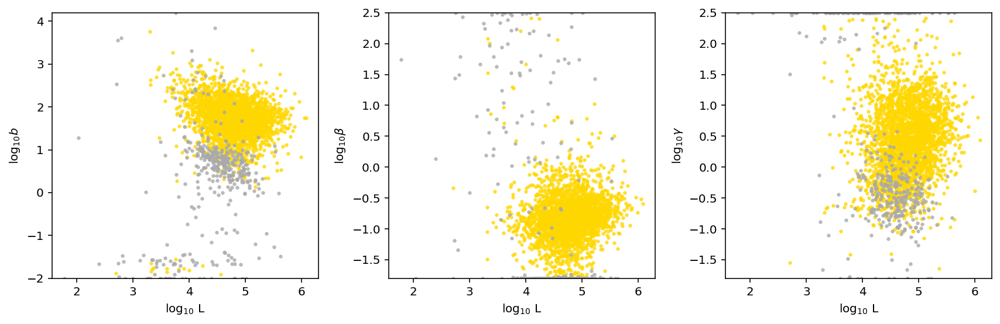

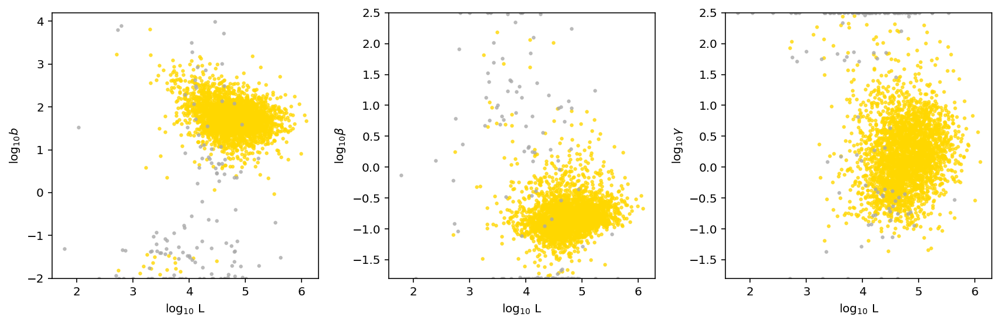

In [18]:
#See parameter fits per dataset
opt=[]
n_cells = []
for sr in sr_arr:
    y = sr.samp_optimum
    print(y)
    opt.append(y)
    n_cells.append(sr.n_cells)
    sr.plot_param_L_dep(plot_errorbars=False,plot_fit=True)
opt = np.asarray(opt)
n_cells = np.asarray(n_cells)

INFO:root:Search data loaded from /home/tchari/perturbCME/notebooks/fits/gg_230208_026_replogle_crispr_1/replogle_allcrispr_sgPMVKa_sgFDPSb/raw.sd.
INFO:root:Figure stored to ./fits/gg_230208_026_replogle_crispr_1/replogle_allcrispr_sgPMVKa_sgFDPSb/Bursty_Poisson_20x21/analysis_figures/subsampling.png.
INFO:root:Figure stored to ./fits/gg_230208_026_replogle_crispr_1/replogle_allcrispr_sgPMVKa_sgFDPSb/Bursty_Poisson_20x21/analysis_figures/subsampling_stability.png.
INFO:root:Search data loaded from /home/tchari/perturbCME/notebooks/fits/gg_230208_026_replogle_crispr_1/replogle_allcrispr_sgPMVKa_sgNegCtrl3b/raw.sd.
INFO:root:Figure stored to ./fits/gg_230208_026_replogle_crispr_1/replogle_allcrispr_sgPMVKa_sgNegCtrl3b/Bursty_Poisson_20x21/analysis_figures/subsampling.png.
INFO:root:Figure stored to ./fits/gg_230208_026_replogle_crispr_1/replogle_allcrispr_sgPMVKa_sgNegCtrl3b/Bursty_Poisson_20x21/analysis_figures/subsampling_stability.png.
INFO:root:Search data loaded from /home/tchari/p

/home/ggorin/projects/monod/src/monod/inference.py:1453: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig1, ax1 = plt.subplots(nrows=1, ncols=Nsamp, figsize=figsize)


INFO:root:Figure stored to ./fits/gg_230208_026_replogle_crispr_1/replogle_allcrispr_sgNegCtrl02093a_sgNegCtrl3b/Bursty_Poisson_20x21/analysis_figures/subsampling_stability.png.
INFO:root:Search data loaded from /home/tchari/perturbCME/notebooks/fits/gg_230208_026_replogle_crispr_1/replogle_allcrispr_sgNegCtrl4a_sgNegCtrl3b/raw.sd.
INFO:root:Figure stored to ./fits/gg_230208_026_replogle_crispr_1/replogle_allcrispr_sgNegCtrl4a_sgNegCtrl3b/Bursty_Poisson_20x21/analysis_figures/subsampling.png.
INFO:root:Figure stored to ./fits/gg_230208_026_replogle_crispr_1/replogle_allcrispr_sgNegCtrl4a_sgNegCtrl3b/Bursty_Poisson_20x21/analysis_figures/subsampling_stability.png.
INFO:root:Search data loaded from /home/tchari/perturbCME/notebooks/fits/gg_230208_026_replogle_crispr_1/replogle_allcrispr_sgNegCtrl8a_sgNegCtrl3b/raw.sd.
INFO:root:Figure stored to ./fits/gg_230208_026_replogle_crispr_1/replogle_allcrispr_sgNegCtrl8a_sgNegCtrl3b/Bursty_Poisson_20x21/analysis_figures/subsampling.png.
INFO:roo

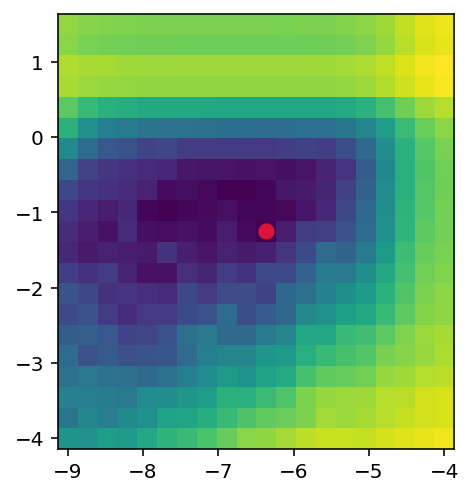

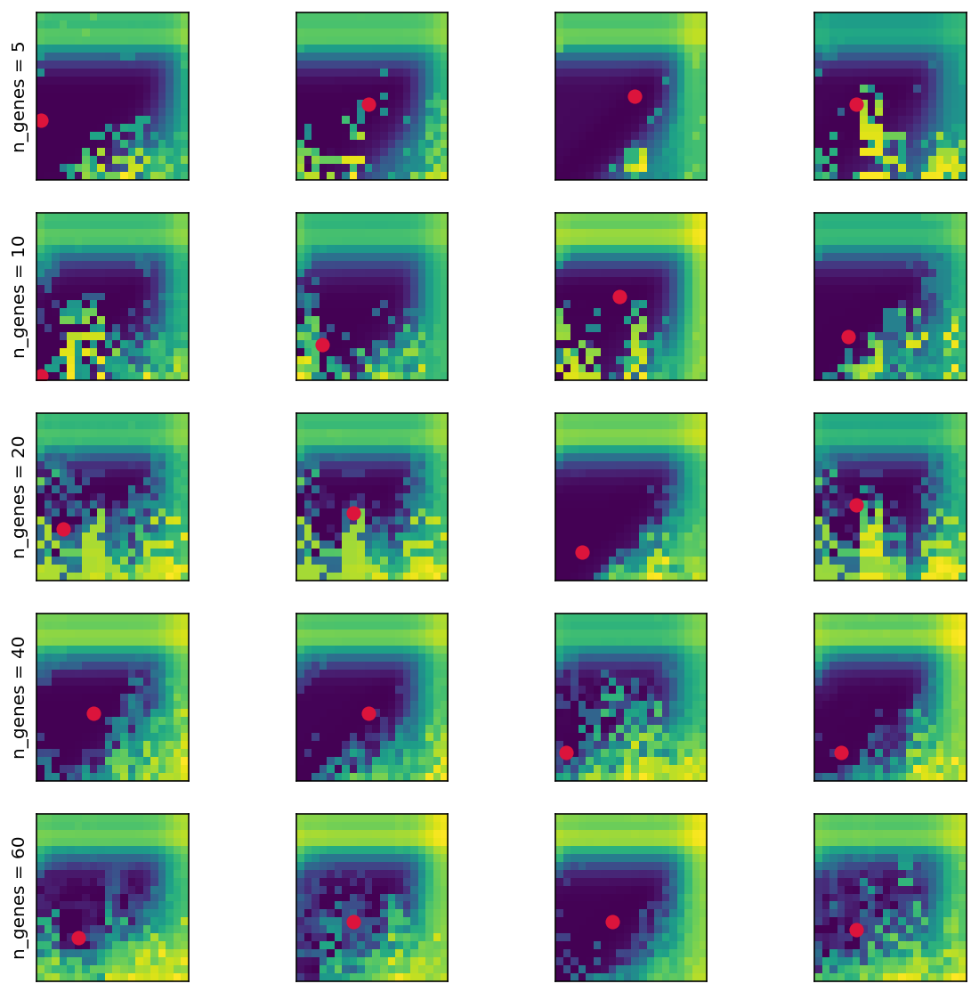

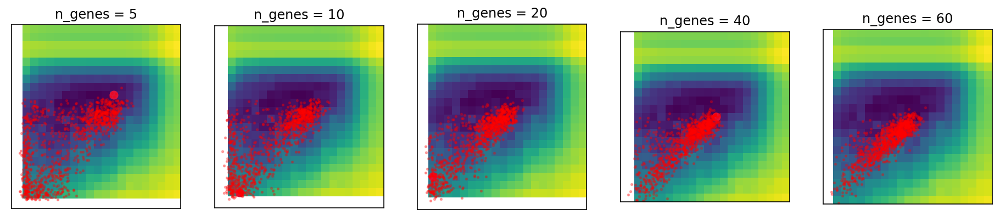

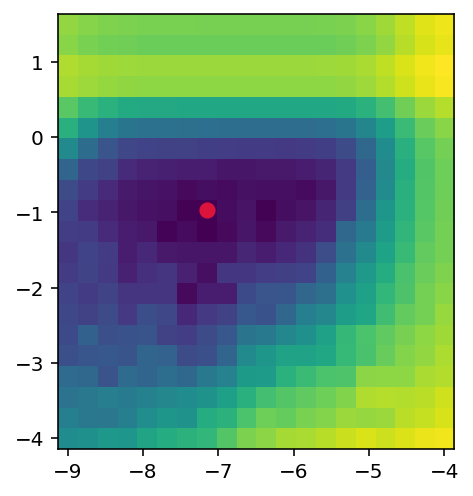

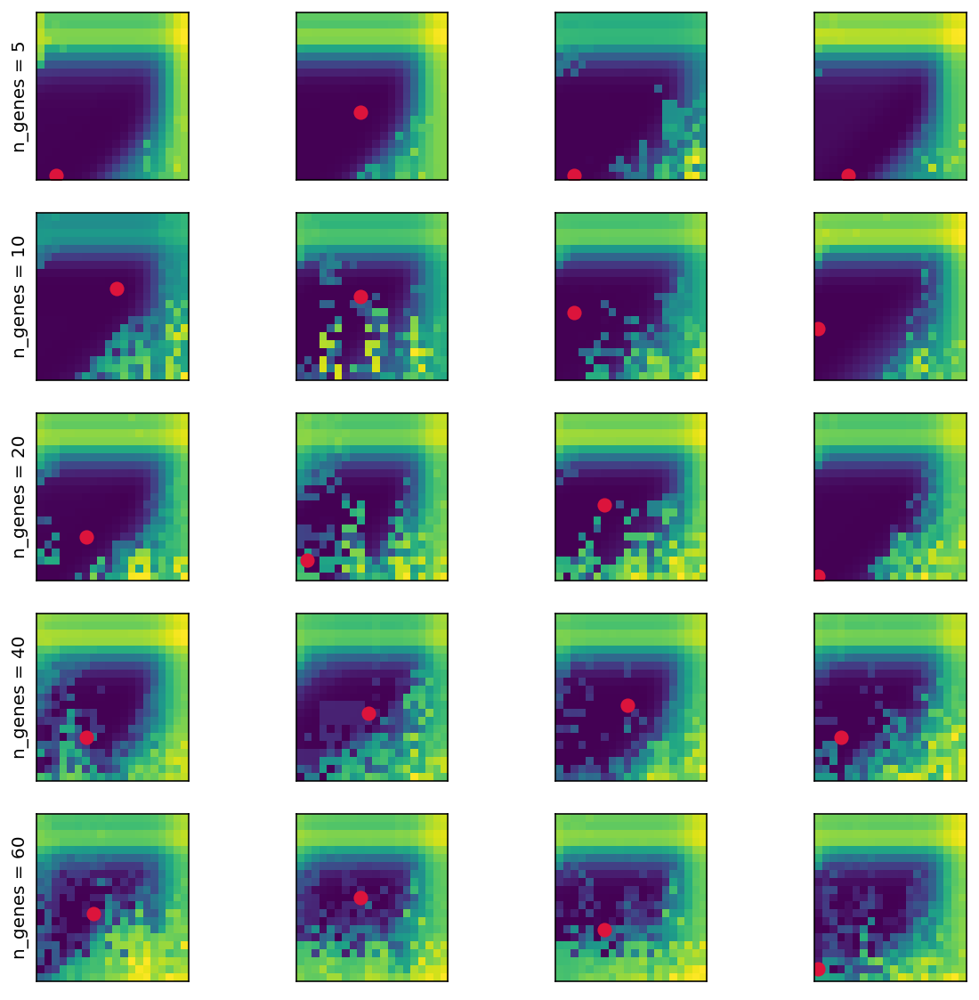

...

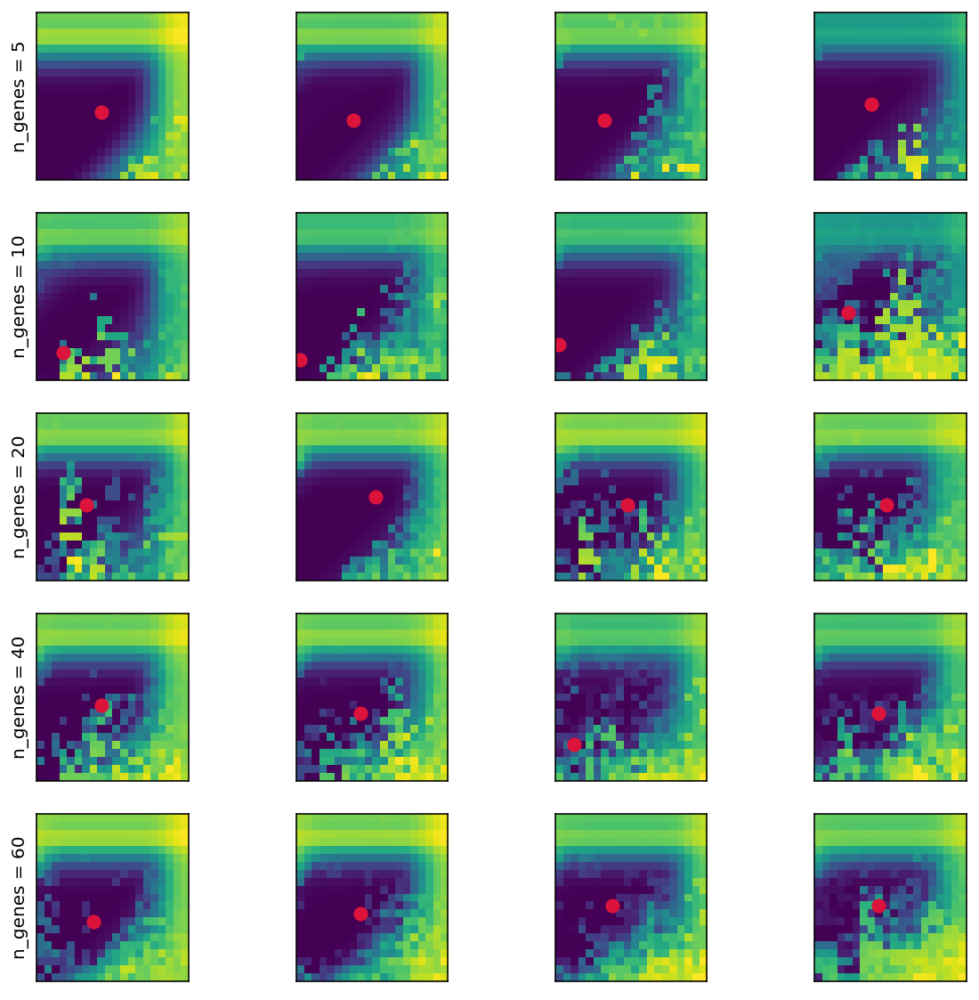

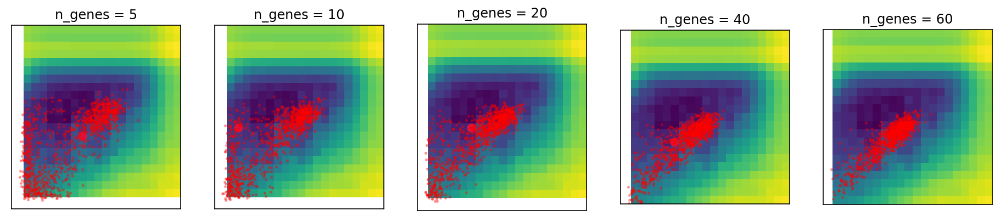

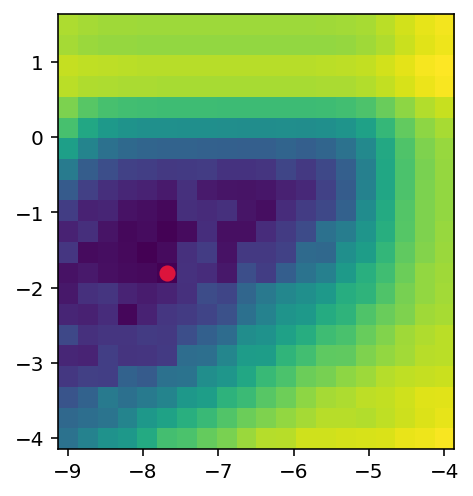

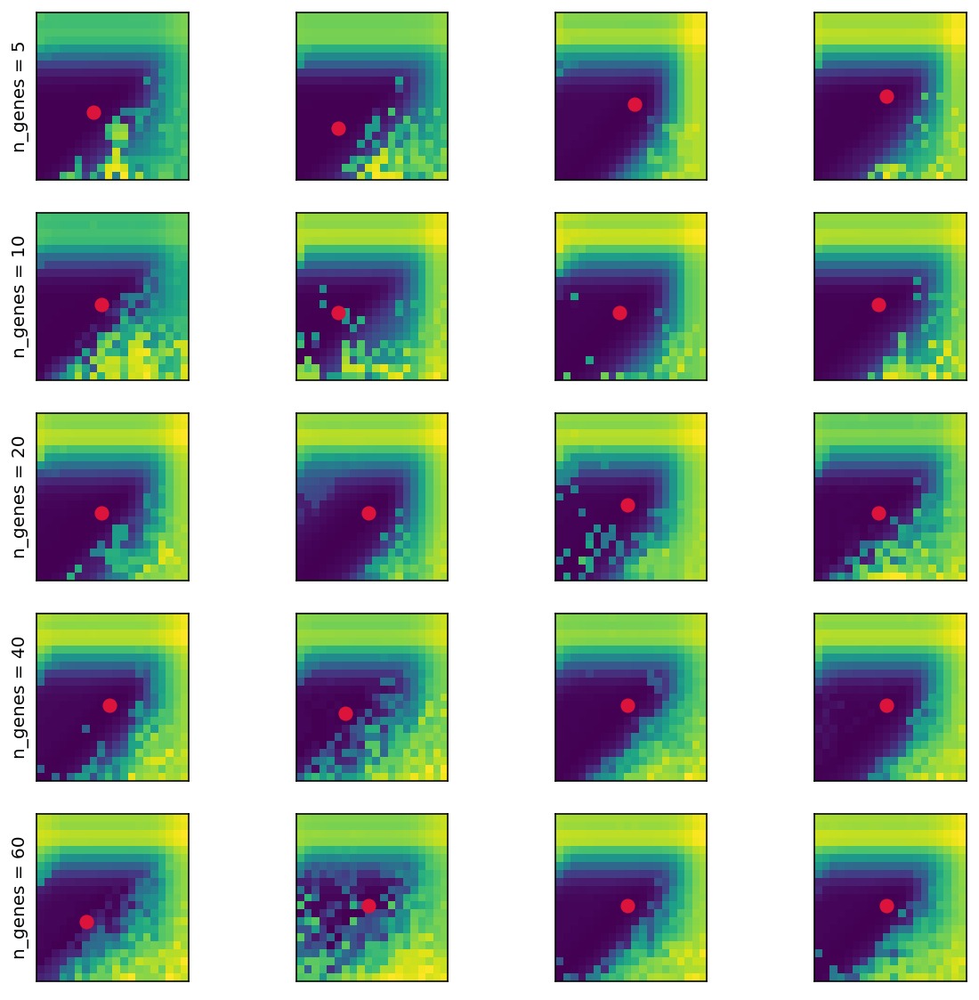

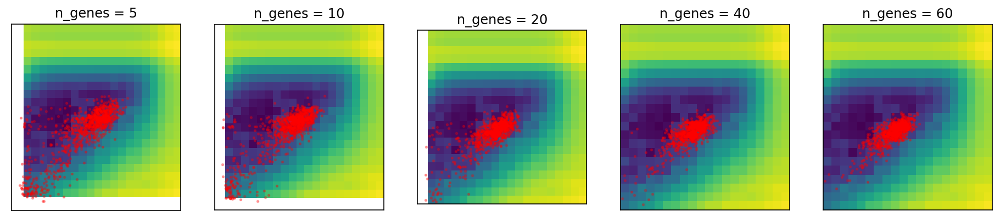

In [19]:
for i in range(len(dataset_names)):
    sr = sr_arr[i]
    sd = monod.analysis.load_search_data(dir_string+'/'+dataset_names[i]+'/raw.sd')
    fig1,ax1 = plt.subplots(1,1)
    sr.plot_landscape(ax1)
    
    sr.resample_opt_viz()
    sr.resample_opt_mc_viz()
    #sr.chisq_best_param_correction(sd,Ntries=4,viz=False,threshold=1e-3) 

In [20]:
xl = np.asarray([sr.sp.samp_lb[0],sr.sp.samp_ub[0]])
yl = np.asarray([sr.sp.samp_lb[1],sr.sp.samp_ub[1]])
x=np.linspace(xl[0],xl[1],sr.sp.gridsize[0])
y=np.linspace(yl[0],yl[1],sr.sp.gridsize[1])

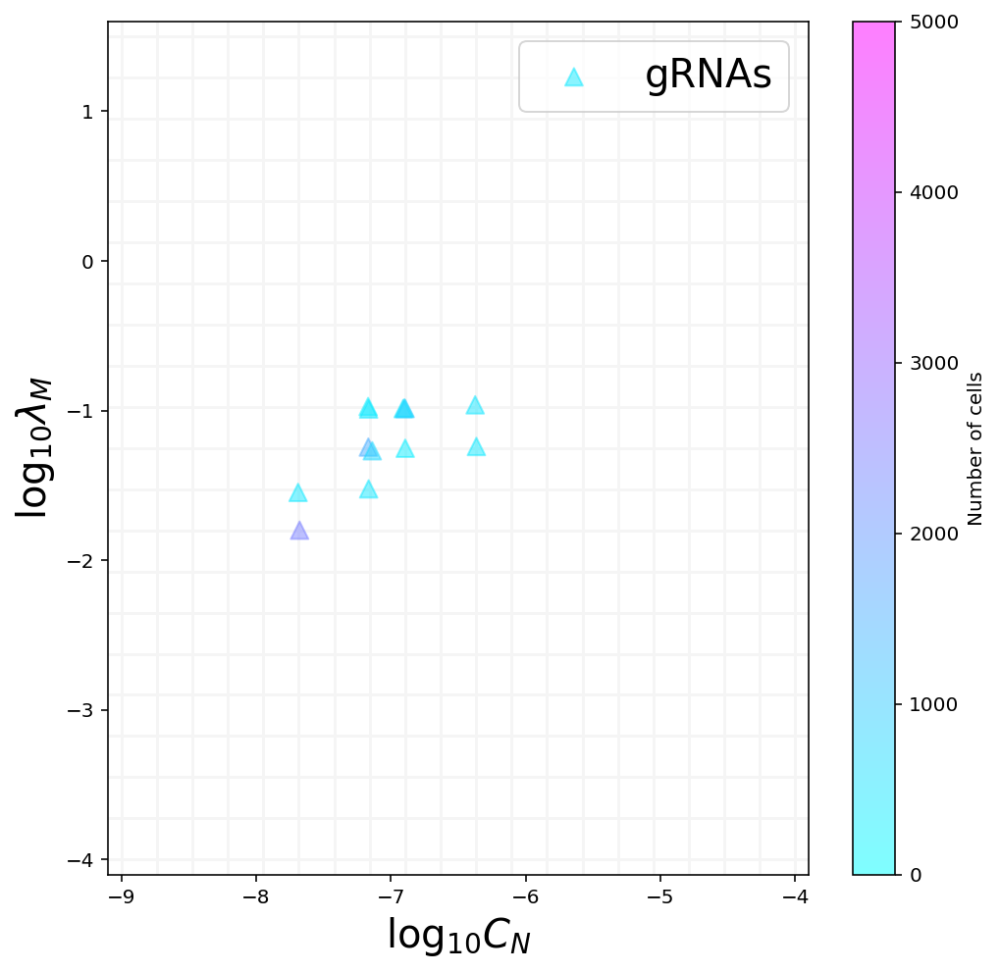

In [21]:
fs = 20
d=0.1

fig1,ax1 = plt.subplots(1,1,figsize=(8,8))
for i in range(sr.sp.gridsize[0]):
    plt.plot([x[i]]*2,yl + [-d,d],c='whitesmoke')
for i in range(sr.sp.gridsize[1]):
    plt.plot(xl+ [-d,d],[y[i]]*2,c='whitesmoke')
jit = np.random.randn(n_datasets,2)*0.01
opt_ = opt+jit
cmap = 'cool'

# ctf = range(6,n_datasets)
# plt.scatter(opt_[ctf,0],opt_[ctf,1],100,n_cells[ctf],zorder=1000,
#             alpha=0.3,cmap=cmap,label='Cell types',vmin=0,vmax=5000)

stf = range(n_datasets) #-1 to exclude combo control

plt.scatter(opt_[stf,0],opt_[stf,1],80,n_cells[stf],marker='^',zorder=1000,
            alpha=0.5,cmap=cmap,label='gRNAs',vmin=0,vmax=5000)
plt.xlim(xl+ [-d,d])
plt.ylim(yl+ [-d,d])

plt.legend(fontsize=fs,loc='upper right')
plt.colorbar(label='Number of cells')

plt.xlabel(r'$\log_{10} C_N$',fontsize=fs)
plt.ylabel(r'$\log_{10} \lambda_M$',fontsize=fs)

fig_string = sr.batch_analysis_string+'/landscape_qc.png'
plt.savefig(fig_string,dpi=450)

**Set sampling params**

In [21]:
for i in range(len(sr_arr)):
    sr = sr_arr[i]
    sr.set_sampling_optimum(sr.sp.sampl_vals.index((-6.894736842105264, -1.25)))  
  
    sd = monod.analysis.load_search_data(dir_string+'/'+dataset_names[i]+'/raw.sd')
    _=sr.chisquare_testing(sd,reject_at_bounds=True,EPS=1e-20)
    #sr.rejection_index = sr.sp.sampl_vals.index((-6.894736842105264, -1.525)) #-

INFO:root:Search data loaded from /home/tchari/perturbCME/notebooks/fits/gg_230208_026_replogle_crispr_1/replogle_allcrispr_sgPMVKa_sgFDPSb/raw.sd.
INFO:root:Chi-square computation complete. Rejected 501 genes out of 3000. Runtime: 5.2 seconds.
INFO:root:Search data loaded from /home/tchari/perturbCME/notebooks/fits/gg_230208_026_replogle_crispr_1/replogle_allcrispr_sgPMVKa_sgNegCtrl3b/raw.sd.
INFO:root:Chi-square computation complete. Rejected 584 genes out of 3000. Runtime: 4.9 seconds.
INFO:root:Search data loaded from /home/tchari/perturbCME/notebooks/fits/gg_230208_026_replogle_crispr_1/replogle_allcrispr_sgNegCtrl02093a_sgFDPSb/raw.sd.
INFO:root:Chi-square computation complete. Rejected 227 genes out of 3000. Runtime: 6.4 seconds.
INFO:root:Search data loaded from /home/tchari/perturbCME/notebooks/fits/gg_230208_026_replogle_crispr_1/replogle_allcrispr_sgHUS1_2a_sgFDPS_2b/raw.sd.
INFO:root:Chi-square computation complete. Rejected 306 genes out of 3000. Runtime: 5.6 seconds.
INFO

Generate matrix of control params versus condition params

In [22]:
#See paired results (best params paired with best control params)
control = 7 #From Fig 2 used replogle_allcrispr_sgNegCtrl4a_sgNegCtrl3b, and maybe 5a_3b?

n_genes = sr_arr[0].n_genes
n_phys_pars = sr_arr[0].sp.n_phys_pars
par_vals_uncorrected = np.zeros((2,n_datasets,n_genes,n_phys_pars))


for j in range(n_datasets):
    par_vals_uncorrected[0,j,:,:] = sr_arr[control].phys_optimum #control params
    par_vals_uncorrected[1,j,:,:] = sr_arr[j].phys_optimum


In [23]:
par_vals_uncorrected[1,:,:,:].shape

(13, 3000, 3)

In [274]:
# np.save('replogle_fits.npy', par_vals_uncorrected[1,:,:,:])

INFO:root:Figure stored to ./fits/gg_230208_026_replogle_crispr_1/analysis_figures/pair_parameter_comparison_12.png.
INFO:root:Figure stored to ./fits/gg_230208_026_replogle_crispr_1/analysis_figures/pair_parameter_comparison_12.png.
INFO:root:Figure stored to ./fits/gg_230208_026_replogle_crispr_1/analysis_figures/pair_parameter_comparison_12.png.
INFO:root:Figure stored to ./fits/gg_230208_026_replogle_crispr_1/analysis_figures/pair_parameter_comparison_12.png.
INFO:root:Figure stored to ./fits/gg_230208_026_replogle_crispr_1/analysis_figures/pair_parameter_comparison_12.png.
INFO:root:Figure stored to ./fits/gg_230208_026_replogle_crispr_1/analysis_figures/pair_parameter_comparison_12.png.
INFO:root:Figure stored to ./fits/gg_230208_026_replogle_crispr_1/analysis_figures/pair_parameter_comparison_12.png.
INFO:root:Figure stored to ./fits/gg_230208_026_replogle_crispr_1/analysis_figures/pair_parameter_comparison_12.png.
INFO:root:Figure stored to ./fits/gg_230208_026_replogle_crispr_

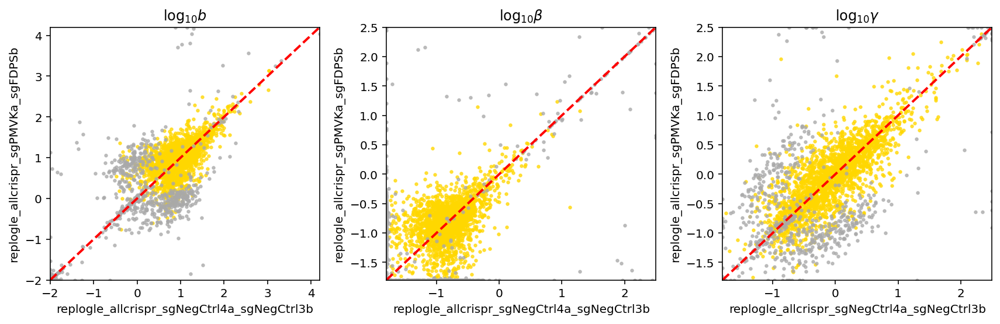

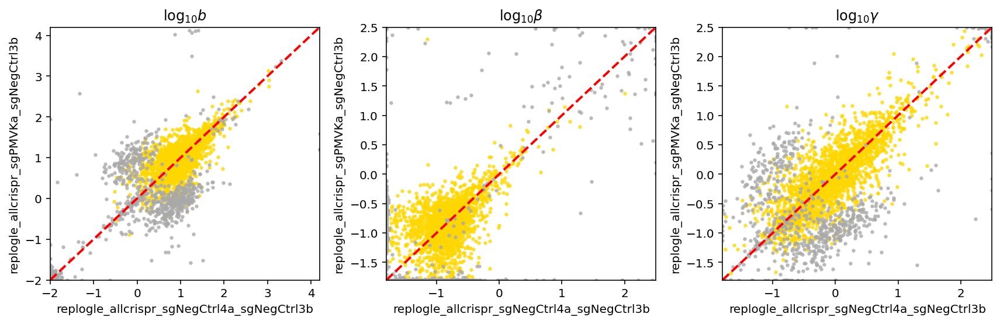

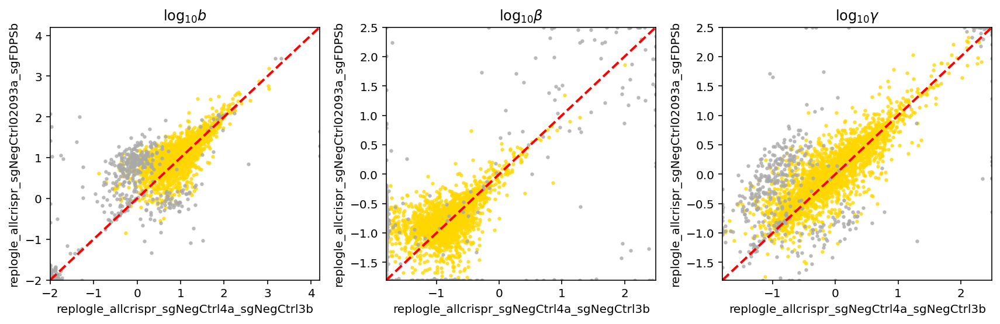

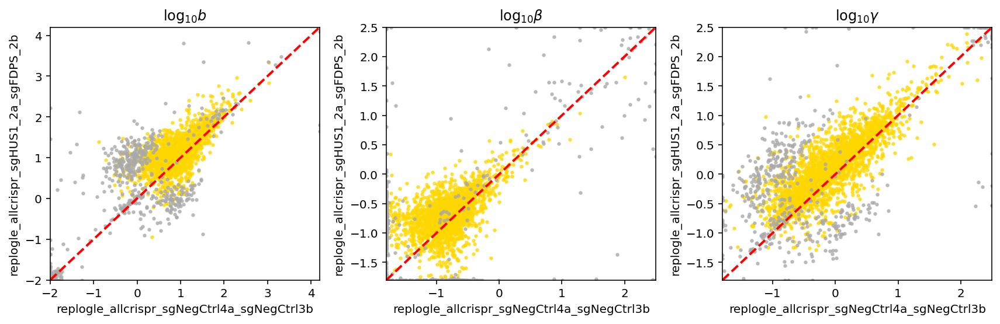

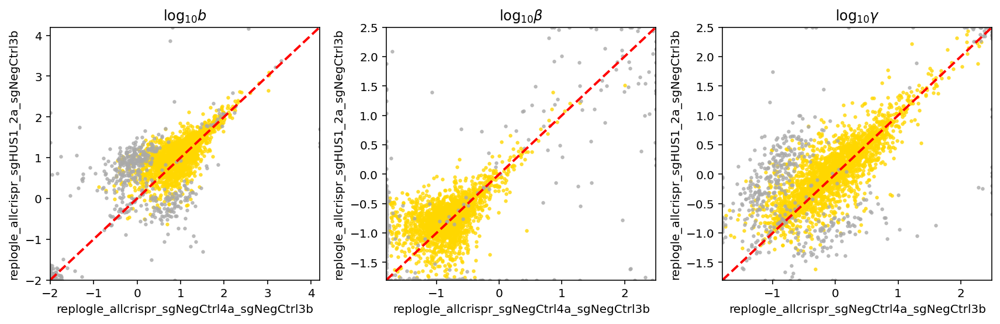

...

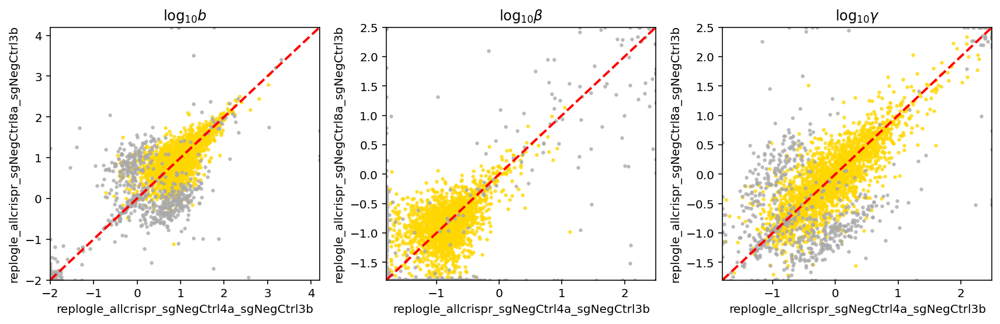

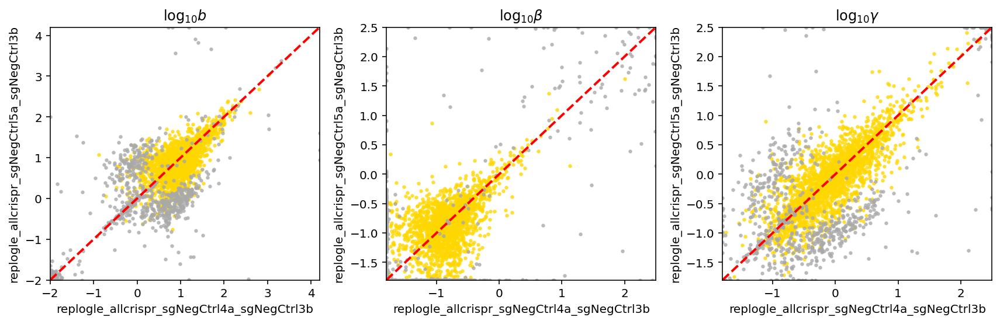

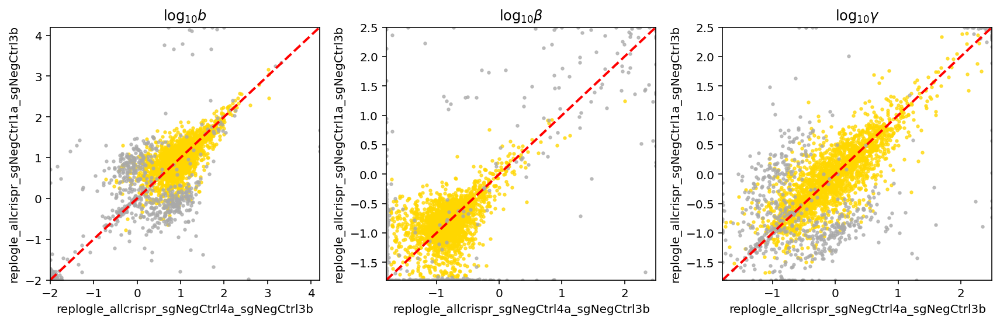

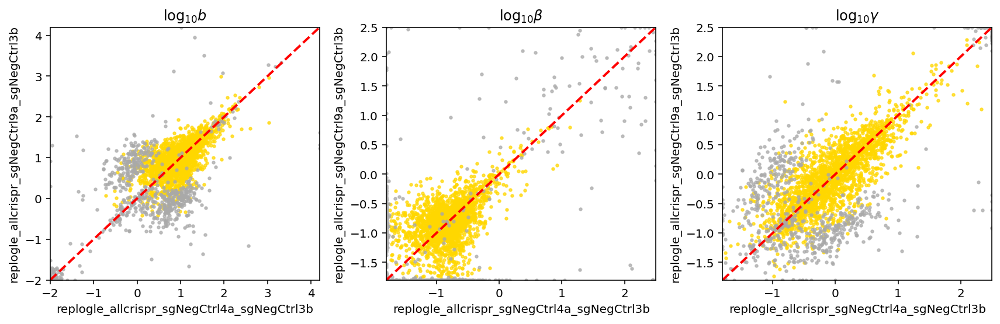

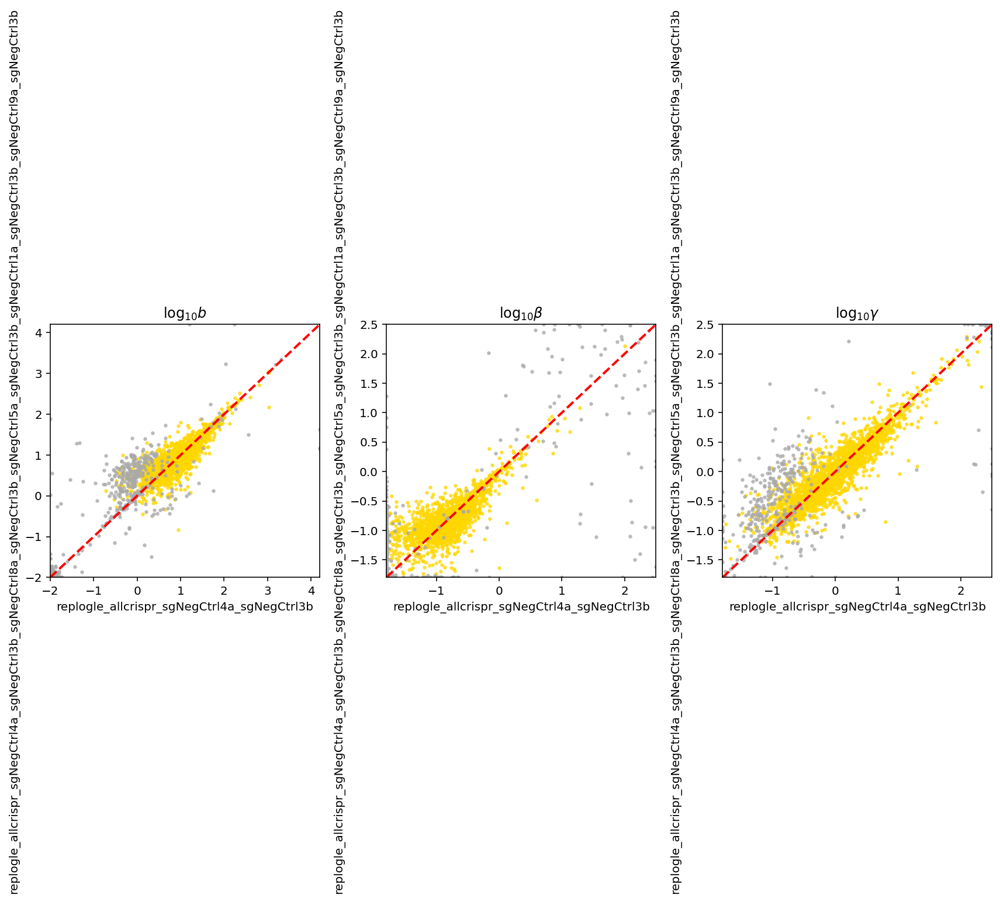

In [21]:
for j in range(n_datasets):
    monod.analysis.plot_params_for_pair(sr_arr[control],sr_arr[j],\
                         distinguish_rej=True,plot_errorbars=False,xlabel = dataset_names[control],\
                         ylabel = dataset_names[j])

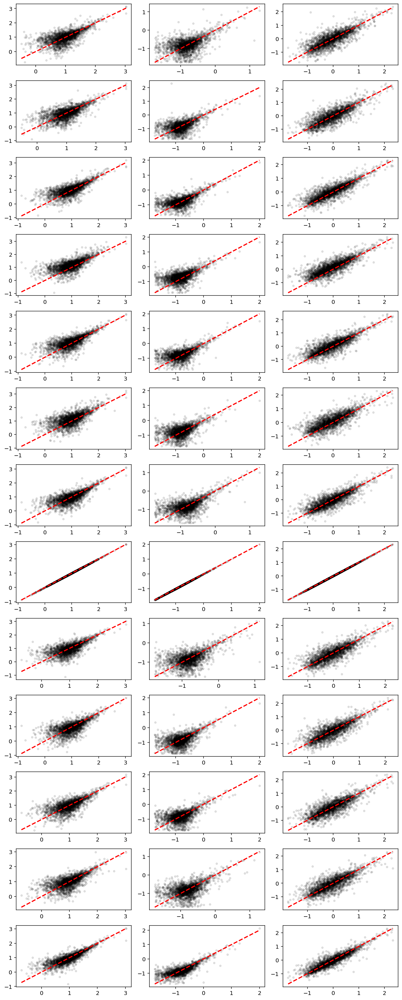

In [22]:
fig1,ax1 = plt.subplots(n_datasets,n_phys_pars,figsize=(10,25))
for d in range(n_datasets):
    #Don't plot rejected genes
    base = sr_arr[control]
    comp = sr_arr[d]

    filt = ~base.rejected_genes & ~comp.rejected_genes

    for k in range(n_phys_pars):
        
        x=par_vals_uncorrected[0,d,filt,k]
        y=par_vals_uncorrected[1,d,filt,k]
        xl = [min(x),max(x)]
        ax1[d,k].scatter(x,y,10,'k',alpha=0.1) 

        ax1[d,k].plot(xl,xl,'r--',linewidth=2)
fig1.tight_layout()

## **Genes of Interest from Study** 
DE Genes identified from Replogle et al. 2020 between perturbed cells

In [24]:
# a e s t h e t i c s
from matplotlib.colors import ListedColormap

#all
col_gold = [203/255,197/255,149/255]
col_gray = [116/255,112/255,113/255]
col_red = [212/255,107/255,75/255]
col_b = ['#1B9AAA']
col_beta = ['#9fcbee']
col_gamma =['#3C50B1']
col_expr = ['#9299A0']

### SI figures
ms = 0.7
lw = ms
ms_fail = 1
alf = 0.3
alf_fail = 0.5
sifig_aesth = (ms,lw,ms_fail,alf,alf_fail)

### Body figures
ms = 2
lw = ms
ms_fail = 2
alf = 0.3
alf_fail = 0.8
msfig_aesth = (ms,lw,ms_fail,alf,alf_fail)

markerstyle = None

c_highlight = col_red
c1 = [173/255,214/255,200/255]
c2 = [59/255,131/255,130/255]
ncol=20
cmap = ListedColormap(np.array([np.linspace(c2[j],c1[j],ncol) for j in range(3)]).T)

In [25]:
pub_meta_2g = pd.read_csv('~/metadata/Figure2g.csv')
pub_meta_2g.head()

,Unnamed: 0,ENO1,PRDX1,SERBP1,FDPS,MAT2A,HSPD1,HSPE1,NCL,PTMA,...,RPS9,RANBP1,RP11-717F1.1,MT-ND1,MT-ND2,MT-CO2,MT-ATP6,MT-CO3,MT-ND3,MT-ND6
0,sgHUS1_2a / sgNegCtrl3b,-0.130356,0.002753,-0.148872,-0.040777,-0.029393,-0.047759,-0.093335,-0.117664,-0.140321,...,0.080245,-0.171497,0.159400,0.110976,-0.006594,0.189993,0.013471,0.228624,0.079783,0.037100
1,sgNegCtrl02093a / sgFDPS_2b,-0.899808,-0.929240,-0.758381,-1.122561,0.929940,-0.963508,-0.965116,-0.986381,-1.003163,...,-0.438863,-0.920145,1.383138,-0.305622,-0.315941,-0.545940,-0.814887,-0.683995,-0.391950,-0.722684
2,sgHUS1_2a / sgFDPS_2b,-0.819117,-0.426150,-0.775788,-1.031531,0.037011,-0.827004,-0.900423,-0.821474,-0.736823,...,0.536981,-0.970679,0.859665,-0.245880,-0.312901,-0.332194,-0.619101,-0.571243,-0.332377,-0.487206
3,model prediction,-0.669642,-0.524990,-0.611683,-0.687682,0.493089,-0.605716,-0.661888,-0.703476,-0.740488,...,-0.152228,-0.731086,0.979659,-0.039212,-0.187626,-0.080044,-0.446978,-0.111698,-0.126116,-0.365907
4,difference,-0.149475,0.098840,-0.164105,-0.343849,-0.456078,-0.221288,-0.238535,-0.117998,0.003665,...,0.689208,-0.239593,-0.119994,-0.206668,-0.125275,-0.252150,-0.172123,-0.459545,-0.206262,-0.121299


In [26]:
pub_meta_2e = pd.read_csv('~/metadata/Figure2e.csv')
pub_meta_2e.head()

,Unnamed: 0,RPA2,PABPC4,FDPS,NCL,ABHD14B,HMGCS1,MAP1B,PSMG4,HIST1H4C,...,BLVRB,APOE,BID,GGA1,SCO2,RP11-717F1.1,WDR4,MT-ND2,MT-CO1,MT-ND6
0,sgPMVKa / sgNegCtrl3b,-0.118526,-0.007609,0.432268,-0.059347,-0.007691,0.661652,0.285970,-0.048790,0.048704,...,-0.007245,-0.047372,-0.101328,0.136035,0.018343,0.166118,0.054596,0.175225,0.002013,0.063578
1,sgNegCtrl02093a / sgFDPSb,0.040528,-0.096716,-1.055800,-0.269781,0.132494,0.206530,-0.019095,0.093712,-0.200602,...,0.462770,0.266767,0.023818,0.088560,-0.080544,0.336515,-0.162014,-0.226586,0.368051,-0.311028
2,sgPMVKa / sgFDPSb,-0.020614,-0.082815,-1.194218,-0.092585,0.009903,0.618096,0.149514,-0.043428,0.035099,...,0.034896,-0.070785,-0.056251,-0.064405,-0.050917,0.006597,-0.035466,-0.039395,0.104480,-0.075902
3,model prediction,-0.016572,-0.017930,-0.093757,-0.057558,0.020978,0.166003,0.053346,0.006259,-0.024428,...,0.077154,0.035928,-0.016006,0.041958,-0.010048,0.090019,-0.016709,-0.003805,0.062901,-0.040238
4,difference,-0.004042,-0.064884,-1.100462,-0.035027,-0.011076,0.452093,0.096168,-0.049687,0.059527,...,-0.042258,-0.106713,-0.040244,-0.106364,-0.040869,-0.083421,-0.018757,-0.035591,0.041580,-0.035665


In [27]:
names_husFDPS = pub_meta_2g.columns.tolist()[1:]
print(len(names_husFDPS))

50


In [28]:
names_pmvkFDPS = pub_meta_2e.columns.tolist()[1:]
print(len(names_pmvkFDPS))

50


## **Set Params Fits and Get S/U Data For Analyses**

In [29]:
par_vals = par_vals_uncorrected

In [30]:
#Uses inds, get S/U counts
sd_arr = []
for i in range(len(dataset_names)): 
    sd_arr += [monod.analysis.load_search_data(dir_string+'/'+dataset_names[i]+'/raw.sd')]

INFO:root:Search data loaded from /home/tchari/perturbCME/notebooks/fits/gg_230208_026_replogle_crispr_1/replogle_allcrispr_sgPMVKa_sgFDPSb/raw.sd.
INFO:root:Search data loaded from /home/tchari/perturbCME/notebooks/fits/gg_230208_026_replogle_crispr_1/replogle_allcrispr_sgPMVKa_sgNegCtrl3b/raw.sd.
INFO:root:Search data loaded from /home/tchari/perturbCME/notebooks/fits/gg_230208_026_replogle_crispr_1/replogle_allcrispr_sgNegCtrl02093a_sgFDPSb/raw.sd.
INFO:root:Search data loaded from /home/tchari/perturbCME/notebooks/fits/gg_230208_026_replogle_crispr_1/replogle_allcrispr_sgHUS1_2a_sgFDPS_2b/raw.sd.
INFO:root:Search data loaded from /home/tchari/perturbCME/notebooks/fits/gg_230208_026_replogle_crispr_1/replogle_allcrispr_sgHUS1_2a_sgNegCtrl3b/raw.sd.
INFO:root:Search data loaded from /home/tchari/perturbCME/notebooks/fits/gg_230208_026_replogle_crispr_1/replogle_allcrispr_sgNegCtrl02093a_sgFDPS_2b/raw.sd.
INFO:root:Search data loaded from /home/tchari/perturbCME/notebooks/fits/gg_2302

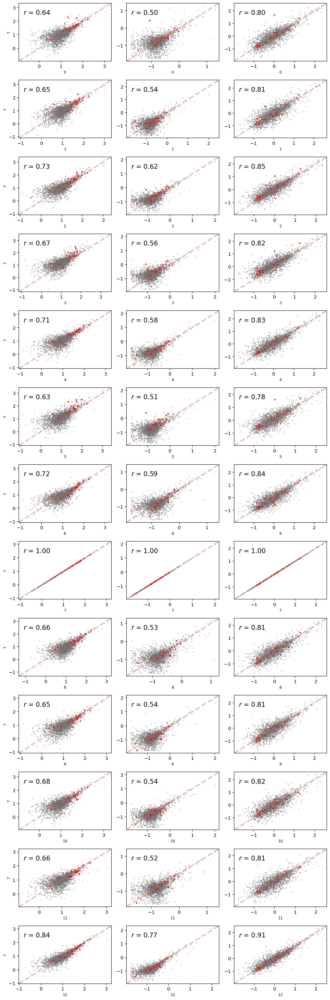

In [30]:
ms,lw,ms_fail,alf,alf_fail = sifig_aesth
c_highlight = col_red
fig1,ax1 = plt.subplots(n_datasets,n_phys_pars,figsize=(10,30))
for d in range(n_datasets):
    #Don't plot rejected genes
    base = sr_arr[control]
    comp = sr_arr[d]
    
    err1 = base.sigma*1.645#2.576
    err2 = comp.sigma*1.645#2.576
        

    filt = ~base.rejected_genes & ~comp.rejected_genes
    remain = np.array(base.gene_names)[filt]
    
    for k in range(n_phys_pars):
        x=par_vals[0,d,filt,k]
        y=par_vals[1,d,filt,k]
        #xl = [min(x),max(x)]
        ax1[d,k].scatter(x,y,color=col_gray,alpha=alf_fail,s=ms_fail) 
        
#         ax1[d,k].errorbar(x,y,err1[filt1,k],err2[filt2,k],
#                           marker=markerstyle,ms=ms,c=col_gold,alpha=alf,linestyle='None',linewidth=lw,zorder=-100)
        
        
        #Get max limits
        maxY = max(ax1[d,k].get_ylim())
        maxX = max(ax1[d,k].get_xlim())
        
        minY = min(ax1[d,k].get_ylim())
        minX = min(ax1[d,k].get_xlim())
        
        plotMax = max([maxY,maxX])
        plotMin = min([minY,minX])
        
        ax1[d,k].set_xlim([plotMin,plotMax])
        ax1[d,k].set_ylim([plotMin,plotMax])
        
        xl = ax1[d,k].get_xlim()
        ax1[d,k].plot(xl,xl,'--',color=c_highlight,linewidth=3,alpha=0.4)
        
        
        #Plot literature genes
        fs=14
        sml=8
        rho=np.corrcoef(x,y)[0][1]
        xl = ax1[d,k].get_xlim()
        ax1[d,k].set_xlabel(str(d),fontsize=sml)

        if k==0:
            ax1[d,k].set_ylabel(str(control),fontsize=sml)
        ax1[d,k].text(.05,.8,r'$r$ = {:.2f}'.format(rho),fontsize=fs,transform=ax1[d,k].transAxes)
        
        #Literature DE genes
        ax1[d,k].scatter(x[pd.Categorical(remain).isin(names_husFDPS+names_pmvkFDPS)],
                         y[pd.Categorical(remain).isin(names_husFDPS+names_pmvkFDPS)],
                         color='red',alpha=0.6,s=7)
        
        
fig1.tight_layout()
fig1.savefig('allSampCorrs.pdf')

## **Test log-additive/multiplicative prediction model**

z-CTRL = a-CTRL + b-CTRL where z=log(param_ab), a=log(param_a),b=log(param_b), CTRL=log(param_CTRL)

Assuming fold changes have cumulative effect

In [31]:
def pred_params(vals,inds,model='mult'):
    '''
    Take in parameter fits from cond1/2, both and control, and indices for each dataset.
    Model is mult (multiplicative) as default, or add (additive)
    Output predictions, z - n_genes x n_params, and fits, true - n_genes x n_params.
    '''
    if model == 'add':
        #MODEL
        
        #z = np.log10(10**(vals[1,inds[0],:,:] - vals[1,inds[-1],:,:]) + 10**(vals[1,inds[1],:,:] - vals[1,inds[-1],:,:]))
        
        #Get previously fit parameter values,'ground truth'
        true = (vals[1,inds[2],:,:] - vals[1,inds[-1],:,:])
        
        
        z = np.log10(1/(1/(10**(vals[1,inds[0],:,:] - vals[1,inds[-1],:,:])) + 1/(10**(vals[1,inds[1],:,:] - vals[1,inds[-1],:,:]))))
        
        #Burst size additive model
        z[:,0] = np.log10(10**(vals[1,inds[0],:,0] - vals[1,inds[-1],:,0]) + 10**(vals[1,inds[1],:,0] - vals[1,inds[-1],:,0]))


    else:
        #MODEL
        
        z = (vals[1,inds[0],:,:] - vals[1,inds[-1],:,:]) + (vals[1,inds[1],:,:] - vals[1,inds[-1],:,:])
        
        #Get previously fit parameter values,'ground truth'
        true = (vals[1,inds[2],:,:] - vals[1,inds[-1],:,:])
   

    return z,true
        

In [32]:
def pred_stds(vals,inds,ctrlInds,model='mult'):
    '''
    Take in parameter fits from cond1/2,both, & control inds, and indices for cond1/2 + both (inds) & control datasets (ctrlInds).
    Model is mult (multiplicative) as default, or add (additive)
    Output std dev of predictions/fits (z and true) per gene, n_genes x n_params.
    '''
    
    allZs = []
    allTrue = []

    for i in ctrlInds:
        inds_ctrl = inds+[i]
        z,true = pred_params(vals,inds_ctrl,model=model)
        
        allZs += [z]
        allTrue += [true]
        
    allPreds = np.concatenate(allZs)
    allTrues = np.concatenate(allTrue)

    #Convert to log2FC
    allPreds = np.log2(10**allPreds)
    allTrues = np.log2(10**allTrues)
    
    err_mat_preds = np.zeros((z.shape[0],3))
    err_mat_trues = np.zeros((z.shape[0],3))
    
    for j in range(err_mat_preds.shape[0]):
        var = np.var(allPreds[j,:],axis=0) #Var for each gene
        err_mat_preds[j,:] = np.sqrt(var)
        
        var = np.var(allTrues[j,:],axis=0) #Var for each gene
        err_mat_trues[j,:] = np.sqrt(var)

    return err_mat_preds,err_mat_trues

In [33]:
def input_for_sel(sd_arr,inds):
    '''
    Take in U/S counts for cond1/2,both, & control, and indices for each dataset.
    Normalize/scale S counts for test/train data for classifier
    Output normaled data (only for cond1/2 and control)
    '''
    
    X1 = sd_arr[inds[0]].layers[1,:,:].T
    X2 = sd_arr[inds[1]].layers[1,:,:].T
    # X_both = sd_arr[inds[2]].layers[1,:,:].T
    X_ctrl = sd_arr[inds[-1]].layers[1,:,:].T
    
    min_size = np.min([X1.shape[0],X2.shape[0],X_ctrl.shape[0]])
    sub_inds = [] 
    for x in [X1,X2,X_ctrl]:
         sub_inds += [random.sample(range(x.shape[0]),min_size)]
            
    #sub_inds = random.sample(range(X_ctrl.shape[0]),X2.shape[0])
    X1 = X1[sub_inds[0],:]
    X2 = X2[sub_inds[1],:]
    X_ctrl = X_ctrl[sub_inds[2],:]

    X_conds = np.concatenate((X1,X2),axis=0) #X_both


    Y_conds = [dataset_names[inds[0]]]*X1.shape[0]+[dataset_names[inds[1]]]*X2.shape[0] #+[dataset_names[inds[2]]]*X_both.shape[0]
    Y_conds_ctrl = Y_conds + [dataset_names[inds[-1]]]*X_ctrl.shape[0]

    Y_conds = np.array(Y_conds)
    Y_conds_ctrl = np.array(Y_conds_ctrl)

    #dataset_names[i]

    #Scale cell reads, * median_reads/reads
    condTot = np.sum(X_conds,axis=1)
    median = np.median(condTot)
    ctrlTot = np.sum(X_ctrl,axis=1)
    facts = median/condTot
    factsCtrl = median/ctrlTot


    X_conds_norm = X_conds*np.repeat(facts.reshape(-1, 1), X_conds.shape[1], 1)
    X_ctrl_norm = X_ctrl*np.repeat(factsCtrl.reshape(-1, 1), X_ctrl.shape[1], 1)

    #Scale controls to same median
    X_conds_ctrl_norm = np.concatenate((X_conds_norm,X_ctrl_norm),axis=0)

    #From each cond, subtract ctrl mean and /std dev (Z-normalization)
    ctrl_mu = np.mean(X_ctrl_norm,axis=0) #For each gene
    ctrl_std = np.std(X_ctrl_norm,axis=0)


    X_conds_norm = (X_conds_norm-ctrl_mu)/(ctrl_std+1e-4) #Can lead to divide by zeros
    X_conds_ctrl_norm = (X_conds_ctrl_norm-ctrl_mu)/(ctrl_std+1e-4)
    
    return X_conds_ctrl_norm, Y_conds_ctrl


In [34]:
def sel_genes(X_conds_ctrl_norm ,Y_conds_ctrl, test_size=0.2,n_jobs = 10,num_features = 100):
    '''
    Take in scaled counts for cond1/2, & control,.
    Split data into test/train for classifier and extract top predictive genes.
    Output top genes for prediction condition label.
    '''
    
    test_size = test_size
    n_jobs = n_jobs

    X = X_conds_ctrl_norm 
    Y = Y_conds_ctrl

    X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=test_size, random_state=42, stratify=Y)

    #From https://github.com/thomasmaxwellnorman/Perturbseq_GI/blob/3b25109aeb9c0c2026bd70abd50304a0ad4e5395/perturbseq/differential_expression.py#L213
    f_repr = 100
    # n_feat * 2 because the training matrix is extended with n shadow features
    multi = ((X_train.shape[1] * 2) / (np.sqrt(X_train.shape[1] * 2) * 10))
    n_estimators = int(multi * f_repr)
    print('n_estimators: ',n_estimators)

    #.fit()
    clf_tree = ExtraTreesClassifier(n_jobs=n_jobs, n_estimators=n_estimators, class_weight='balanced', random_state=42)
    clf_tree.fit(X_train, Y_train)

    #.predict() on X_test
    Y_pred = clf_tree.predict(X_test)

    #get accuracy_score and classification_report
    acc = accuracy_score(Y_test, Y_pred)
    print('Feature prediction accuracy (test size: {1:.1f}%): {0}\n'.format(acc, 100*test_size))
    
    print('Unpredicted labels: ', set(Y_test) - set(Y_pred))
   
    
    report = classification_report(Y_test, Y_pred)
    print(report)


    #get feature_importances
    num_features = num_features #Top 100 genes for now

    idx = np.argsort(clf_tree.feature_importances_)[::-1]
    gene_indices = idx[0:num_features]
    top_gene_names = cond1_res.gene_names[gene_indices]
    
    plt.scatter(range(len(idx)),clf_tree.feature_importances_[idx])
    plt.vlines(f_repr,np.min(clf_tree.feature_importances_[idx]),np.max(clf_tree.feature_importances_[idx]))
    
    return top_gene_names


In [211]:
def sel_logreg_genes(X_conds_ctrl_norm ,Y_conds_ctrl, clf_inds= [0,1],test_size=0.2,num_features = 100):
    '''
    Get genes with monotonic or inversely correlated FCs (from MoM estimates). 
    Corr = 'pos' for monotonic, 'neg' for inverse corrs
    '''
    # clf = LogisticRegression(random_state=0).fit(X, y)
    # Y_pred = clf.predict(X[:2, :])
    # acc = accuracy_score(Y_test, Y_pred)
    # #Top num_features from all weights, for now + np.unique()
    
    test_size = test_size

    X = X_conds_ctrl_norm 
    Y = Y_conds_ctrl

    X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=test_size, random_state=42, stratify=Y)
    
    clf = LogisticRegression(random_state=0,max_iter=1000).fit(X_train, Y_train)
    
    
    Y_pred = clf.predict(X_test)

    #get accuracy_score and classification_report
    acc = accuracy_score(Y_test, Y_pred)
    print('Feature prediction accuracy (test size: {1:.1f}%): {0}\n'.format(acc, 100*test_size))
    
    print('Unpredicted labels: ', set(Y_test) - set(Y_pred))

    subs = np.abs(clf.coef_[clf_inds,:])
    tops = np.argsort(subs.flatten())[::-1][0:num_features] #Top weighted genes
    inds = np.unravel_index(tops, subs.shape)
    top_gene_names = np.unique(cond1_res.gene_names[inds[1]])
    print('No. unique genes selected: ', len(top_gene_names))
    
    print(clf.classes_)
    
    plt.scatter(range(100),subs[inds[0],inds[1]])
    
#     idx = np.argsort(clf.coefs_[0,:])[::-1]
#     gene_indices = idx[0:num_features]
#     top_gene_names = cond1_res.gene_names[gene_indices]
    
    
#     plt.scatter(range(len(idx)),clf_tree.feature_importances_[idx])
    
    return top_gene_names
        
    
    

In [35]:
def plot_preds_params(z,true,filt,err_pred,err_true,filtSub=None,xlab = 'Pred', ylab='Fit', figsize=(5,5),alpha=0.7,s=5,corr=True,fs=14,fname=None,colors=[col_b[0],col_beta[0],col_gamma[0]],subColors=['red','red','red']):
    fig, (ax1,ax2,ax3) = plt.subplots(1, 3,figsize=figsize)

    z = np.log2(10**z)
    true = np.log2(10**true)
    
    #burst size
    ax1.errorbar(z[filt,0],true[filt,0],err_pred[filt,0],err_true[filt,0],
                 marker=markerstyle,ms=ms,c=colors[0],alpha=alf,linestyle='None',linewidth=lw/1.5,zorder=-100)

    ax1.scatter(z[filt,0],true[filt,0],color=[colors[0]],alpha=alpha,s=s,edgecolors='black',linewidths=.4)
    
    maxY = max(ax1.get_ylim())
    maxX = max(ax1.get_xlim())

    minY = min(ax1.get_ylim())
    minX = min(ax1.get_xlim())

    plotMax = max([maxY,maxX])
    plotMin = min([minY,minX])

    ax1.set_xlim([plotMin,plotMax])
    ax1.set_ylim([plotMin,plotMax])
    
    if filtSub is not None:
        ax1.errorbar(z[filtSub,0],true[filtSub,0],err_pred[filtSub,0],err_true[filtSub,0],
                     marker=markerstyle,ms=ms,c=subColors[0],alpha=alf,linestyle='None',linewidth=lw/1.5,zorder=-100)

        ax1.scatter(z[filtSub,0],true[filtSub,0],color=subColors[0],alpha=0.7,s=s+5,edgecolors='black',linewidths=.4)

    rho = np.corrcoef(z[filt,0],true[filt,0])[0][1]
    p = scipy.stats.spearmanr(z[filt,0],true[filt,0])[0]
    if corr:
        ax1.text(.05,.7,r'$r$ = {:.2f}'.format(rho),fontsize=fs,transform=ax1.transAxes)
        ax1.text(.05,.8,r'$\rho$ = {:.2f}'.format(p),fontsize=fs,transform=ax1.transAxes)
    xl = ax1.get_xlim()
    ax1.plot(xl,xl,'--',color=col_gray,linewidth=3,alpha=0.4)
    
    
    
    #beta
        
    ax2.errorbar(z[filt,1],true[filt,1],err_pred[filt,1],err_true[filt,1],
                 marker=markerstyle,ms=ms,c=colors[1],alpha=alf,linestyle='None',linewidth=lw/1.5,zorder=-100)
    ax2.scatter(z[filt,1],true[filt,1],color=[colors[1]],alpha=alpha,s=s,edgecolors='black',linewidths=.4)
    maxY = max(ax2.get_ylim())
    maxX = max(ax2.get_xlim())

    minY = min(ax2.get_ylim())
    minX = min(ax2.get_xlim())

    plotMax = max([maxY,maxX])
    plotMin = min([minY,minX])

    ax2.set_xlim([plotMin,plotMax])
    ax2.set_ylim([plotMin,plotMax])
    
    if filtSub is not None:
        ax2.errorbar(z[filtSub,1],true[filtSub,1],err_pred[filtSub,1],err_true[filtSub,1],
                     marker=markerstyle,ms=ms,c=subColors[1],alpha=alf,linestyle='None',linewidth=lw/1.5,zorder=-100)

        ax2.scatter(z[filtSub,1],true[filtSub,1],color=subColors[1],alpha=0.7,s=s+5,edgecolors='black',linewidths=.4)

    
    rho = np.corrcoef(z[filt,1],true[filt,1])[0][1]
    p = scipy.stats.spearmanr(z[filt,1],true[filt,1])[0]
    if corr:
        ax2.text(.05,.7,r'$r$ = {:.2f}'.format(rho),fontsize=fs,transform=ax2.transAxes)
        ax2.text(.05,.8,r'$\rho$ = {:.2f}'.format(p),fontsize=fs,transform=ax2.transAxes)
    xl = ax2.get_xlim()
    ax2.plot(xl,xl,'--',color=col_gray,linewidth=3,alpha=0.4)
    
    
    #gamma
        
    ax3.errorbar(z[filt,2],true[filt,2],err_pred[filt,2],err_true[filt,2],
                 marker=markerstyle,ms=ms,c=colors[2],alpha=alf,linestyle='None',linewidth=lw/1.5,zorder=-100)
    ax3.scatter(z[filt,2],true[filt,2],color=[colors[2]],alpha=alpha,s=s,edgecolors='black',linewidths=.4)
    maxY = max(ax3.get_ylim())
    maxX = max(ax3.get_xlim())

    minY = min(ax3.get_ylim())
    minX = min(ax3.get_xlim())

    plotMax = max([maxY,maxX])
    plotMin = min([minY,minX])

    ax3.set_xlim([plotMin,plotMax])
    ax3.set_ylim([plotMin,plotMax])
    
    if filtSub is not None:
        ax3.errorbar(z[filtSub,2],true[filtSub,2],err_pred[filtSub,2],err_true[filtSub,2],
                     marker=markerstyle,ms=ms,c=subColors[2],alpha=alf,linestyle='None',linewidth=lw/1.5,zorder=-100)

        ax3.scatter(z[filtSub,2],true[filtSub,2],color=subColors[2],alpha=0.7,s=s+5,edgecolors='black',linewidths=.4)
        
    rho = np.corrcoef(z[filt,2],true[filt,2])[0][1]
    p = scipy.stats.spearmanr(z[filt,2],true[filt,2])[0]
    if corr:
        ax3.text(.05,.7,r'$r$ = {:.2f}'.format(rho),fontsize=fs,transform=ax3.transAxes)
        ax3.text(.05,.8,r'$\rho$ = {:.2f}'.format(p),fontsize=fs,transform=ax3.transAxes)
    xl = ax3.get_xlim()
    ax3.plot(xl,xl,'--',color=col_gray,linewidth=3,alpha=0.4)
     
    
    ax1.set_title(r'$b$ log2FC')
    ax2.set_title(r'$\beta$ log2FC')
    ax3.set_title(r'$\gamma$ log2FC')
    
    ax1.set_xlabel(xlab)
    ax1.set_ylabel(ylab)
    
    if fname is not None:
        plt.savefig(fname)
    
    

In [252]:
def plot_preds_multAdd(z,true,filt,err_pred,err_true,sd_arr,inds,mod=1,xlab = 'Pred', ylab='Fit', figsize=(5,5),alpha=0.7,s=5,corr=True,fs=14,fname=None,colors=[col_b[0],col_beta[0],col_gamma[0]],subColors=['red','red','red']):
    fig, axs = plt.subplots(4, 3,figsize=figsize)

    z = np.log2(10**z)
    true = np.log2(10**true)
    
    #Mean spliced/unspliced preds
    guess_add = np.log2(np.mean(sd_arr[inds[0]].layers[mod][filt,:],axis=1)/np.mean(sd_arr[inds[-1]].layers[mod][filt,:],axis=1) + np.mean(sd_arr[inds[1]].layers[mod][filt,:],axis=1)/np.mean(sd_arr[inds[-1]].layers[mod][filt,:],axis=1))
    true_vals_add = np.log2(np.mean(sd_arr[inds[2]].layers[mod][filt,:],axis=1)/np.mean(sd_arr[inds[-1]].layers[mod][filt,:],axis=1))
    err_add = (guess_add - true_vals_add)**2
    
    guess_mult = np.log2(np.mean(sd_arr[inds[0]].layers[mod][filt,:],axis=1)/np.mean(sd_arr[inds[-1]].layers[mod][filt,:],axis=1))+np.log2(np.mean(sd_arr[inds[1]].layers[mod][filt,:],axis=1)/np.mean(sd_arr[inds[-1]].layers[mod][filt,:],axis=1))
    true_vals_mult = np.log2(np.mean(sd_arr[inds[2]].layers[mod][filt,:],axis=1)/np.mean(sd_arr[inds[-1]].layers[mod][filt,:],axis=1))
    err_mult = (guess_mult - true_vals_mult)**2
    
    
    #burst size
    axs[0,0].errorbar(z[filt,0],true[filt,0],err_pred[filt,0],err_true[filt,0],
                 marker=markerstyle,ms=ms,c='lightgrey',alpha=alf,linestyle='None',linewidth=lw/1.5,zorder=-100)
    sc = axs[0,0].scatter(z[filt,0],true[filt,0],c=err_add,alpha=alpha,s=s,edgecolors='black',linewidths=.4)
    
    plt.colorbar(sc,ax=axs[0,0])
    
    axs[1,0].errorbar(z[filt,0],true[filt,0],err_pred[filt,0],err_true[filt,0],
                 marker=markerstyle,ms=ms,c='lightgrey',alpha=alf,linestyle='None',linewidth=lw/1.5,zorder=-100)
    sc = axs[1,0].scatter(z[filt,0],true[filt,0],c=err_mult,alpha=alpha,s=s,edgecolors='black',linewidths=.4)
    plt.colorbar(sc,ax=axs[1,0])
    
    for a in [axs[0,0],axs[1,0]]:
        maxY = max(a.get_ylim())
        maxX = max(a.get_xlim())

        minY = min(a.get_ylim())
        minX = min(a.get_xlim())

        plotMax = max([maxY,maxX])
        plotMin = min([minY,minX])

        a.set_xlim([plotMin,plotMax])
        a.set_ylim([plotMin,plotMax])

        rho = np.corrcoef(z[filt,0],true[filt,0])[0][1]
        p = scipy.stats.spearmanr(z[filt,0],true[filt,0])[0]
        if corr:
            a.text(.05,.7,r'$r$ = {:.2f}'.format(rho),fontsize=fs,transform=a.transAxes)
            a.text(.05,.8,r'$\rho$ = {:.2f}'.format(p),fontsize=fs,transform=a.transAxes)
        xl = a.get_xlim()
        a.plot(xl,xl,'--',color=col_gray,linewidth=3,alpha=0.4)
        
   
    
    
    #beta
        
    axs[0,1].errorbar(z[filt,1],true[filt,1],err_pred[filt,1],err_true[filt,1],
                 marker=markerstyle,ms=ms,c='lightgrey',alpha=alf,linestyle='None',linewidth=lw/1.5,zorder=-100)
    sc=axs[0,1].scatter(z[filt,1],true[filt,1],c=err_add,alpha=alpha,s=s,edgecolors='black',linewidths=.4)
    plt.colorbar(sc,ax=axs[0,1])
    
    axs[1,1].errorbar(z[filt,1],true[filt,1],err_pred[filt,1],err_true[filt,1],
                 marker=markerstyle,ms=ms,c='lightgrey',alpha=alf,linestyle='None',linewidth=lw/1.5,zorder=-100)
    sc=axs[1,1].scatter(z[filt,1],true[filt,1],c=err_mult,alpha=alpha,s=s,edgecolors='black',linewidths=.4)
    plt.colorbar(sc,ax=axs[1,1])
    
    
    for a in [axs[0,1],axs[1,1]]:
        maxY = max(a.get_ylim())
        maxX = max(a.get_xlim())

        minY = min(a.get_ylim())
        minX = min(a.get_xlim())

        plotMax = max([maxY,maxX])
        plotMin = min([minY,minX])

        a.set_xlim([plotMin,plotMax])
        a.set_ylim([plotMin,plotMax])
    
        rho = np.corrcoef(z[filt,1],true[filt,1])[0][1]
        p = scipy.stats.spearmanr(z[filt,1],true[filt,1])[0]
        if corr:
            a.text(.05,.7,r'$r$ = {:.2f}'.format(rho),fontsize=fs,transform=a.transAxes)
            a.text(.05,.8,r'$\rho$ = {:.2f}'.format(p),fontsize=fs,transform=a.transAxes)
        xl = a.get_xlim()
        a.plot(xl,xl,'--',color=col_gray,linewidth=3,alpha=0.4)

    
    #gamma
        
    axs[0,2].errorbar(z[filt,2],true[filt,2],err_pred[filt,2],err_true[filt,2],
                 marker=markerstyle,ms=ms,c='lightgrey',alpha=alf,linestyle='None',linewidth=lw/1.5,zorder=-100)
    sc=axs[0,2].scatter(z[filt,2],true[filt,2],c=err_add,alpha=alpha,s=s,edgecolors='black',linewidths=.4)
    plt.colorbar(sc,ax=axs[0,2])
    
    axs[1,2].errorbar(z[filt,2],true[filt,2],err_pred[filt,2],err_true[filt,2],
                 marker=markerstyle,ms=ms,c='lightgrey',alpha=alf,linestyle='None',linewidth=lw/1.5,zorder=-100)
    sc=axs[1,2].scatter(z[filt,2],true[filt,2],c=err_mult,alpha=alpha,s=s,edgecolors='black',linewidths=.4)
    plt.colorbar(sc,ax=axs[1,2])
    
    
    for a in [axs[0,2],axs[1,2]]:
        maxY = max(a.get_ylim())
        maxX = max(a.get_xlim())

        minY = min(a.get_ylim())
        minX = min(a.get_xlim())

        plotMax = max([maxY,maxX])
        plotMin = min([minY,minX])

        a.set_xlim([plotMin,plotMax])
        a.set_ylim([plotMin,plotMax])

        rho = np.corrcoef(z[filt,2],true[filt,2])[0][1]
        p = scipy.stats.spearmanr(z[filt,2],true[filt,2])[0]
        if corr:
            a.text(.05,.7,r'$r$ = {:.2f}'.format(rho),fontsize=fs,transform=a.transAxes)
            a.text(.05,.8,r'$\rho$ = {:.2f}'.format(p),fontsize=fs,transform=a.transAxes)
        xl = a.get_xlim()
        a.plot(xl,xl,'--',color=col_gray,linewidth=3,alpha=0.4)
        
    # ------ Plot of err in S pred and err in param pred ------
    for ps in range(3):
        pred_err = (z[filt,ps] - true[filt,ps])**2
        axs[2,ps].scatter(err_add,pred_err,color=[colors[ps]],
                         alpha=alpha,s=s,edgecolors='black',linewidths=.4)

        maxY = max(axs[2,ps].get_ylim())
        maxX = max(axs[2,ps].get_xlim())

        minY = min(axs[2,ps].get_ylim())
        minX = min(axs[2,ps].get_xlim())

        plotMax = max([maxY,maxX])
        plotMin = min([minY,minX])

        axs[2,ps].set_xlim([plotMin,plotMax])
        axs[2,ps].set_ylim([plotMin,plotMax])

        rho = np.corrcoef(err_add,pred_err)[0][1]
        p = scipy.stats.spearmanr(err_add,pred_err)[0]
        if corr:
            axs[2,ps].text(.05,.7,r'$r$ = {:.2f}'.format(rho),fontsize=fs,transform=axs[2,ps].transAxes)
            axs[2,ps].text(.05,.8,r'$\rho$ = {:.2f}'.format(p),fontsize=fs,transform=axs[2,ps].transAxes)
        xl = axs[2,ps].get_xlim()
        axs[2,ps].plot(xl,xl,'--',color=col_gray,linewidth=3,alpha=0.4)

        axs[2,ps].set_xlabel('Mean Pred Err (Add.)')
        axs[2,ps].set_ylabel('param'+str(ps)+' Pred log2FC Err')

        #Plot for mult pred of b
        axs[3,ps].scatter(err_mult,pred_err,color=[colors[ps]],
                         alpha=alpha,s=s,edgecolors='black',linewidths=.4)

        maxY = max(axs[3,ps].get_ylim())
        maxX = max(axs[3,ps].get_xlim())

        minY = min(axs[3,ps].get_ylim())
        minX = min(axs[3,ps].get_xlim())

        plotMax = max([maxY,maxX])
        plotMin = min([minY,minX])

        axs[3,ps].set_xlim([plotMin,plotMax])
        axs[3,ps].set_ylim([plotMin,plotMax])

        rho = np.corrcoef(err_mult,pred_err)[0][1]
        p = scipy.stats.spearmanr(err_mult,pred_err)[0]
        if corr:
            axs[3,ps].text(.05,.7,r'$r$ = {:.2f}'.format(rho),fontsize=fs,transform=axs[3,ps].transAxes)
            axs[3,ps].text(.05,.8,r'$\rho$ = {:.2f}'.format(p),fontsize=fs,transform=axs[3,ps].transAxes)
        xl = axs[3,ps].get_xlim()
        axs[3,ps].plot(xl,xl,'--',color=col_gray,linewidth=3,alpha=0.4)

        axs[3,ps].set_xlabel('Mean Pred Err (Mult.)')
        axs[3,ps].set_ylabel('param'+str(ps)+' Pred log2FC Err')
     
    
    axs[0,0].set_title(r'$b$ log2FC  (Add.)')
    axs[0,1].set_title(r'$\beta$ log2FC (Add.)')
    axs[0,2].set_title(r'$\gamma$ log2FC (Add.)')
    
    axs[1,0].set_title(r'$b$ log2FC  (Mult.)')
    axs[1,1].set_title(r'$\beta$ log2FC (Mult.)')
    axs[1,2].set_title(r'$\gamma$ log2FC (Mult.)')
    
    axs[0,0].set_xlabel(xlab)
    axs[0,0].set_ylabel(ylab)
    
    plt.tight_layout()
    
    if fname is not None:
        plt.savefig(fname)
    else:
        plt.show()
    
    

**Set indices of datasets for prediction**

In [253]:
for i in range(len(dataset_names)):
    print(str(i)+': '+dataset_names[i])

0: replogle_allcrispr_sgPMVKa_sgFDPSb
1: replogle_allcrispr_sgPMVKa_sgNegCtrl3b
2: replogle_allcrispr_sgNegCtrl02093a_sgFDPSb
3: replogle_allcrispr_sgHUS1_2a_sgFDPS_2b
4: replogle_allcrispr_sgHUS1_2a_sgNegCtrl3b
5: replogle_allcrispr_sgNegCtrl02093a_sgFDPS_2b
6: replogle_allcrispr_sgNegCtrl02093a_sgNegCtrl3b
7: replogle_allcrispr_sgNegCtrl4a_sgNegCtrl3b
8: replogle_allcrispr_sgNegCtrl8a_sgNegCtrl3b
9: replogle_allcrispr_sgNegCtrl5a_sgNegCtrl3b
10: replogle_allcrispr_sgNegCtrl1a_sgNegCtrl3b
11: replogle_allcrispr_sgNegCtrl9a_sgNegCtrl3b
12: replogle_allcrispr_sgNegCtrl4a_sgNegCtrl3b_sgNegCtrl8a_sgNegCtrl3b_sgNegCtrl5a_sgNegCtrl3b_sgNegCtrl1a_sgNegCtrl3b_sgNegCtrl9a_sgNegCtrl3b


In [254]:
ctrlInds = [6,7,8,9,10,11]

In [226]:
# control = 9 #9 for PMVKa/sgFDPSb maybe?, 7 for HUS12a/FDPS2b

In [227]:
# #Set results to use
# inds = [1,2,0,control] #1,2,0 PMVKa/sgFDPSb  or 4,5,3 HUS12a/FDPS2b

In [228]:
# #Neg control inds
# inds_neg = [8,10,0,control]  #0 or 3 for both cond

**Predictions for PMVKa/sgFDPSb**

In [255]:
control = 9 #9 for PMVKa/sgFDPSb maybe?, 7 for HUS12a/FDPS2b -->SEEMS LIKE if you have combined control, less predictive power in neg ctrl model
#Set results to use
inds = [1,2,0,control] #1,2,0 PMVKa/sgFDPSb  or 4,5,3 HUS12a/FDPS2b
#Neg control inds
inds_neg = [8,10,0,control]  #0 or 3 for both cond

Make gene filters for prediction

n_estimators:  774
Feature prediction accuracy (test size: 20.0%): 0.450261780104712

Unpredicted labels:  set()
                                            precision    recall  f1-score   support

replogle_allcrispr_sgNegCtrl02093a_sgFDPSb       0.48      0.48      0.48        63
replogle_allcrispr_sgNegCtrl5a_sgNegCtrl3b       0.41      0.55      0.47        64
    replogle_allcrispr_sgPMVKa_sgNegCtrl3b       0.50      0.33      0.40        64

                                  accuracy                           0.45       191
                                 macro avg       0.46      0.45      0.45       191
                              weighted avg       0.46      0.45      0.45       191

% literature genes in top predicted: 41.67% 
% literature genes in top predicted: 41.67% 


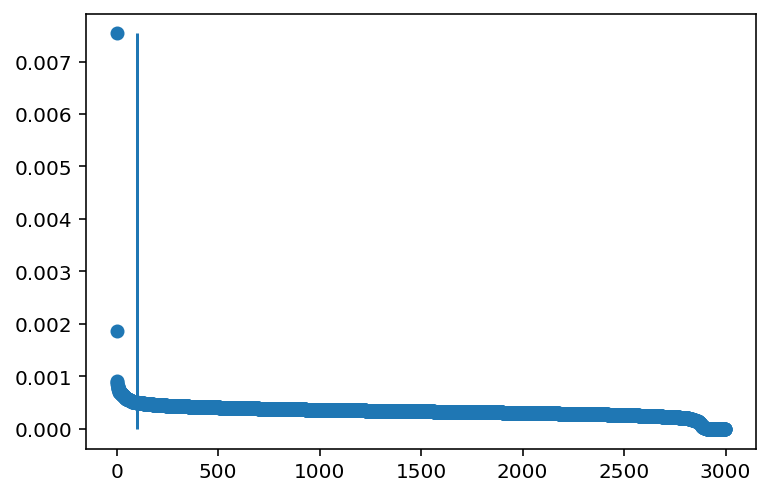

In [256]:
#Make gene filters

cond1_res = sr_arr[inds[0]]  
cond2_res = sr_arr[inds[1]]
both_res = sr_arr[inds[2]]
ctrl_res = sr_arr[inds[-1]]  
  

forFilt = ~cond1_res.rejected_genes & ~cond2_res.rejected_genes & ~ctrl_res.rejected_genes #& ~both_res.rejected_genes
remainAll = cond1_res.gene_names[forFilt]



#Get only DE genes from study, that are not rejected
forFiltSub_husFDPS = forFilt & pd.Categorical(cond1_res.gene_names).isin(names_husFDPS)
remainAllSub = np.array(cond1_res.gene_names)[forFiltSub_husFDPS]


forFiltSub_pmvkFDPS = forFilt & pd.Categorical(cond1_res.gene_names).isin(names_pmvkFDPS)



#Run RF classifier
X,Y = input_for_sel(sd_arr,inds)
top_genes = sel_genes(X,Y, test_size=0.2,n_jobs = 10,num_features = 100)

forFiltSub_top= forFilt & pd.Categorical(cond1_res.gene_names).isin(top_genes)



overlap = np.sum(forFiltSub_top & forFiltSub_husFDPS)/np.sum(forFiltSub_husFDPS)*100
print('% literature genes in top predicted: '+"{:.2f}".format(overlap)+'% ')

overlap = np.sum(forFiltSub_top & forFiltSub_pmvkFDPS)/np.sum(forFiltSub_pmvkFDPS)*100
print('% literature genes in top predicted: '+"{:.2f}".format(overlap)+'% ')

Feature prediction accuracy (test size: 20.0%): 0.3403141361256545

Unpredicted labels:  set()
No. unique genes selected:  95
['replogle_allcrispr_sgNegCtrl02093a_sgFDPSb'
 'replogle_allcrispr_sgNegCtrl5a_sgNegCtrl3b'
 'replogle_allcrispr_sgPMVKa_sgNegCtrl3b']


/home/tchari/miniconda3/envs/py37/lib/python3.7/site-packages/sklearn/linear_model/_logistic.py:818: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG,


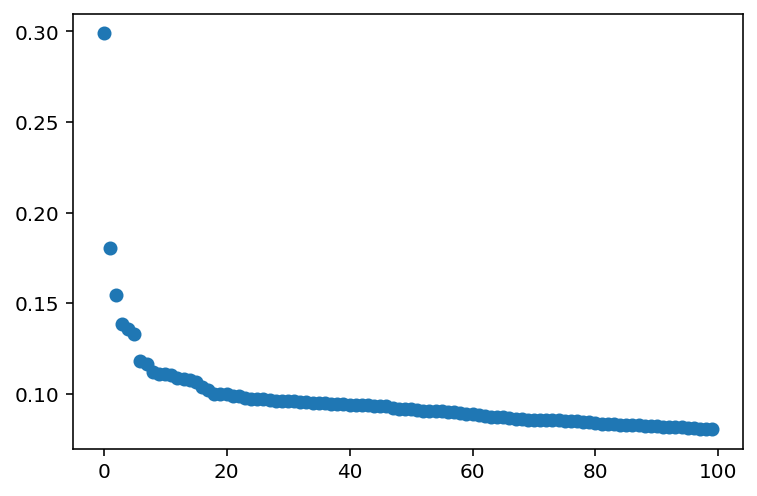

In [225]:
top_genes = sel_logreg_genes(X,Y,clf_inds=[0,2])
forFiltSub_top= forFilt & pd.Categorical(cond1_res.gene_names).isin(top_genes)


Predictions

In [257]:
z,true  = pred_params(par_vals,inds,model='mult')
std_z, std_true = pred_stds(par_vals,inds,ctrlInds,model='mult')

In [258]:
z_neg,true_neg  = pred_params(par_vals,inds_neg,model='mult')
std_z_neg, std_true_neg = pred_stds(par_vals,inds_neg,ctrlInds,model='mult')

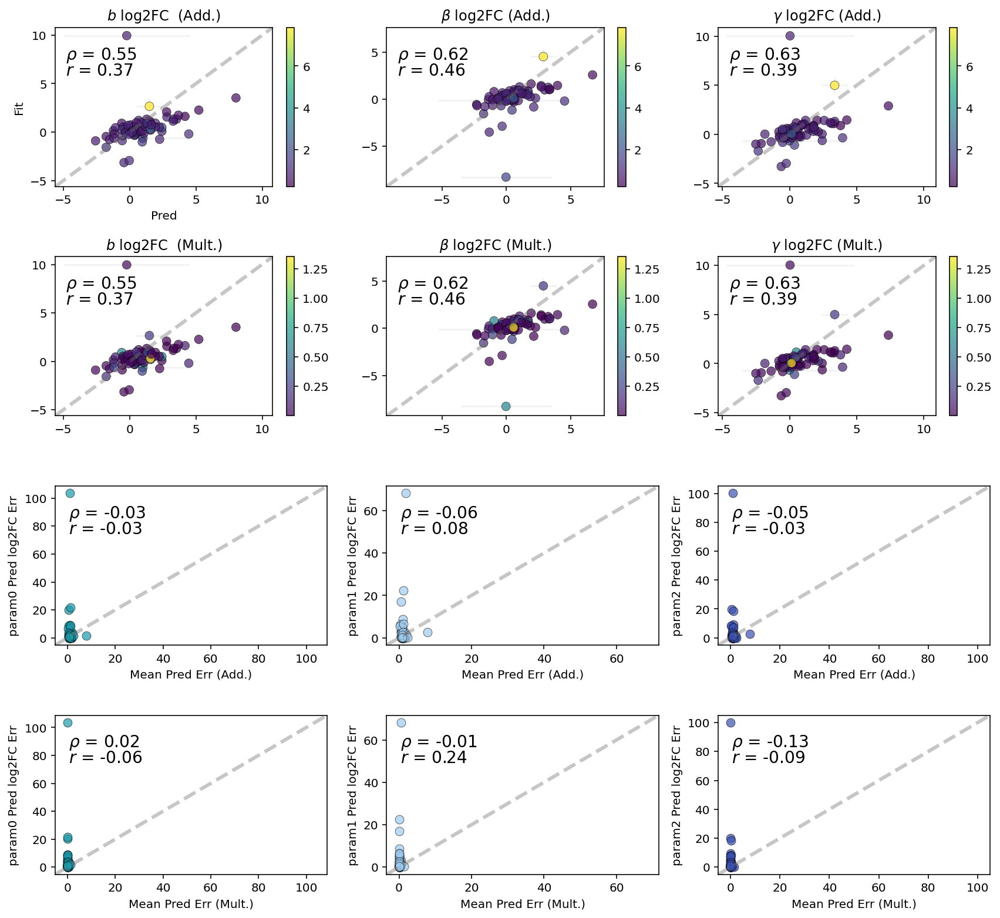

In [259]:
plot_preds_multAdd(z,true,forFiltSub_top,std_z,std_true,sd_arr,inds,mod=1,s=55,figsize=(12,11))

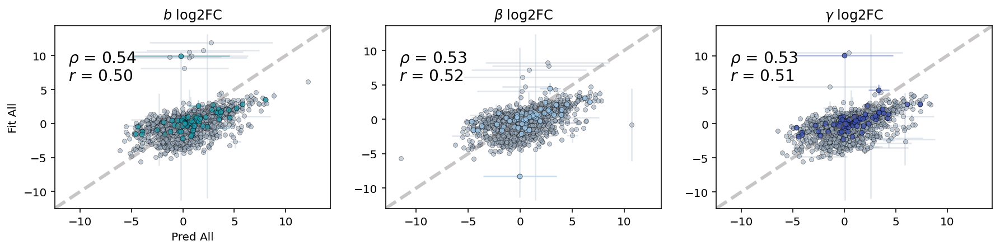

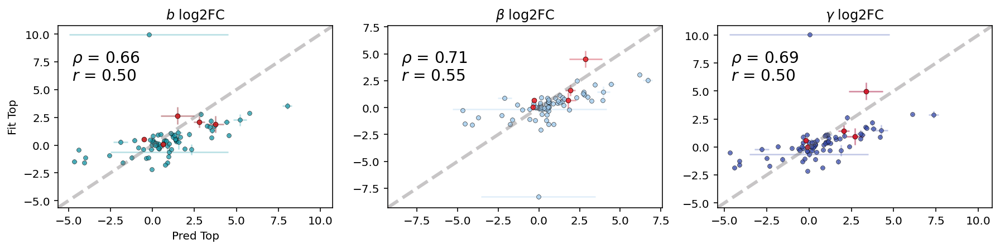

In [53]:

plot_preds_params(z,true,forFilt,std_z,std_true,forFiltSub_top,xlab = 'Pred All', ylab='Fit All',
                  colors=['#A1B2C4','#A1B2C4','#A1B2C4'],subColors=[col_b[0],col_beta[0],col_gamma[0]],
                  figsize=(15,3),alpha=0.5,s=15 )

plot_preds_params(z,true,forFiltSub_top,std_z,std_true,forFiltSub_top&forFiltSub_pmvkFDPS,
                  xlab = 'Pred Top', ylab='Fit Top', 
                  figsize=(15,3),alpha=0.7,s=15)



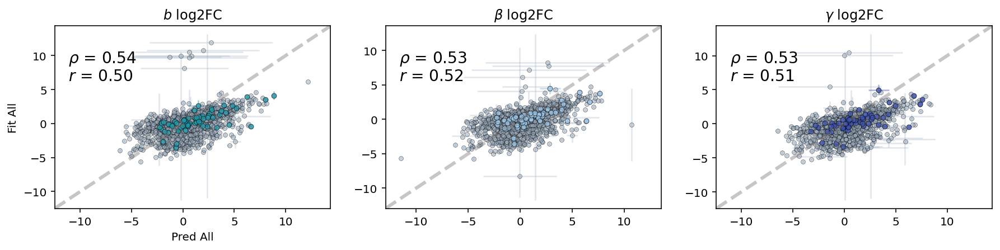

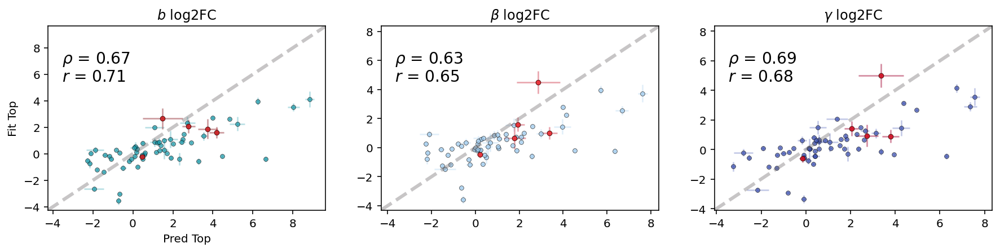

In [228]:
#logreg
plot_preds_params(z,true,forFilt,std_z,std_true,forFiltSub_top,xlab = 'Pred All', ylab='Fit All',
                  colors=['#A1B2C4','#A1B2C4','#A1B2C4'],subColors=[col_b[0],col_beta[0],col_gamma[0]],
                  figsize=(15,3),alpha=0.5,s=15 )

plot_preds_params(z,true,forFiltSub_top,std_z,std_true,forFiltSub_top&forFiltSub_pmvkFDPS,
                  xlab = 'Pred Top', ylab='Fit Top', 
                  figsize=(15,3),alpha=0.7,s=15)



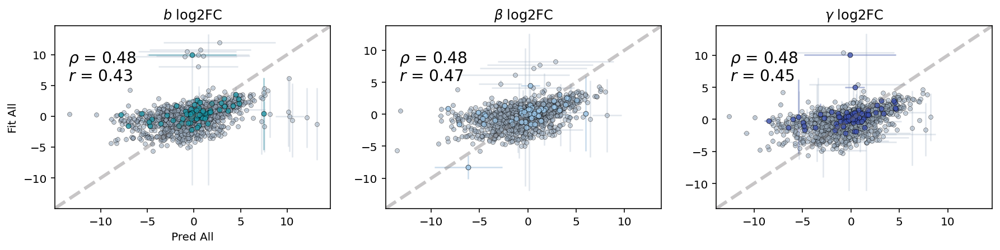

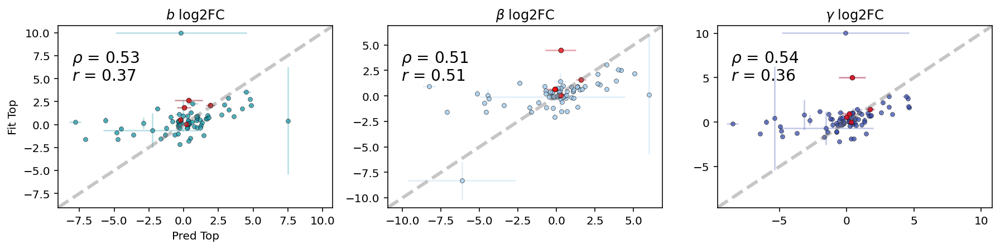

In [54]:

plot_preds_params(z_neg,true_neg,forFilt,std_z_neg,std_true_neg,forFiltSub_top,xlab = 'Pred All', ylab='Fit All',
                  colors=['#A1B2C4','#A1B2C4','#A1B2C4'],subColors=[col_b[0],col_beta[0],col_gamma[0]],
                  figsize=(15,3),alpha=0.5,s=15 )

plot_preds_params(z_neg,true_neg,forFiltSub_top,std_z_neg,std_true_neg,forFiltSub_top&forFiltSub_pmvkFDPS,
                  xlab = 'Pred Top', ylab='Fit Top', 
                  figsize=(15,3),alpha=0.7,s=15)



In [260]:
z,true  = pred_params(par_vals,inds,model='add')
std_z, std_true = pred_stds(par_vals,inds,ctrlInds,model='add')

In [261]:
z_neg,true_neg  = pred_params(par_vals,inds_neg,model='add')
std_z_neg, std_true_neg = pred_stds(par_vals,inds_neg,ctrlInds,model='add')

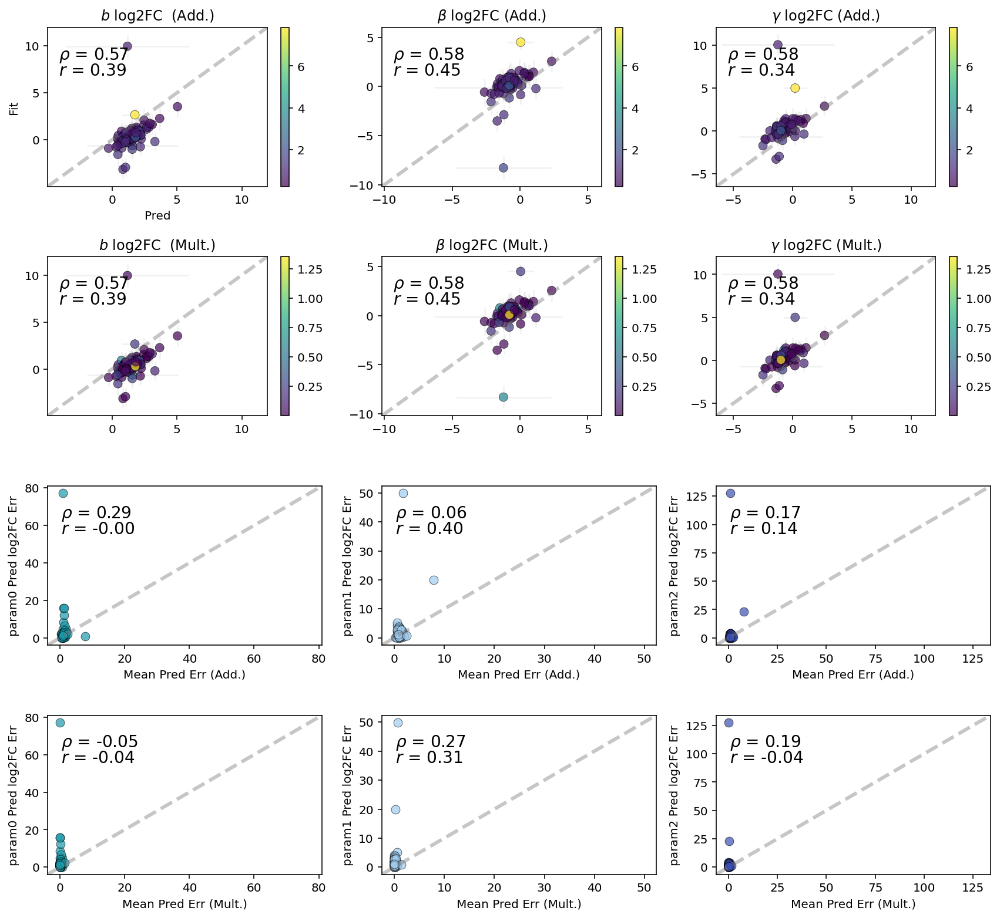

In [262]:
plot_preds_multAdd(z,true,forFiltSub_top,std_z,std_true,sd_arr,inds,mod=1,s=55,figsize=(12,11))

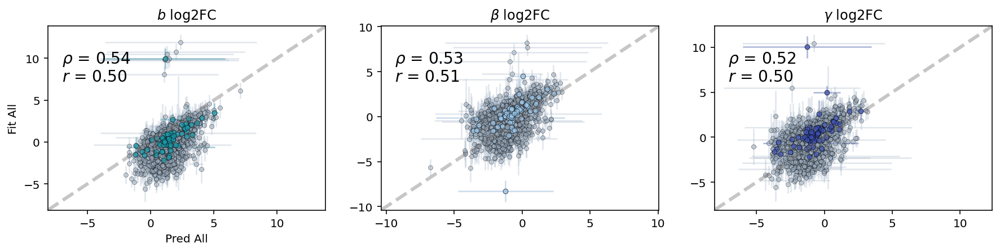

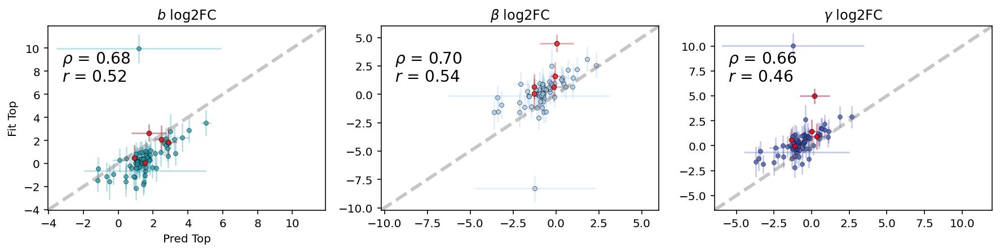

In [57]:

plot_preds_params(z,true,forFilt,std_z,std_true,forFiltSub_top,xlab = 'Pred All', ylab='Fit All',
                  colors=['#A1B2C4','#A1B2C4','#A1B2C4'],subColors=[col_b[0],col_beta[0],col_gamma[0]],
                  figsize=(15,3),alpha=0.5,s=15 )

plot_preds_params(z,true,forFiltSub_top,std_z,std_true,forFiltSub_top&forFiltSub_pmvkFDPS,
                  xlab = 'Pred Top', ylab='Fit Top', 
                  figsize=(15,3),alpha=0.7,s=15)



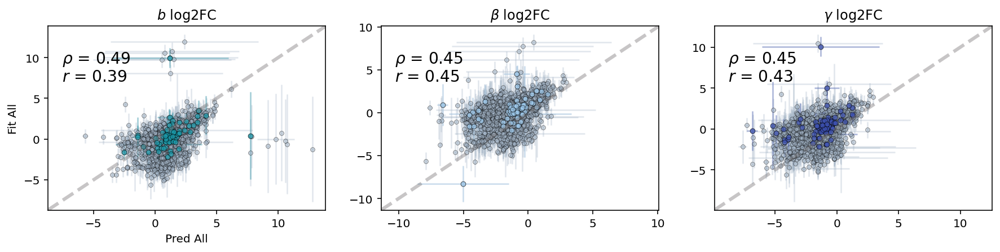

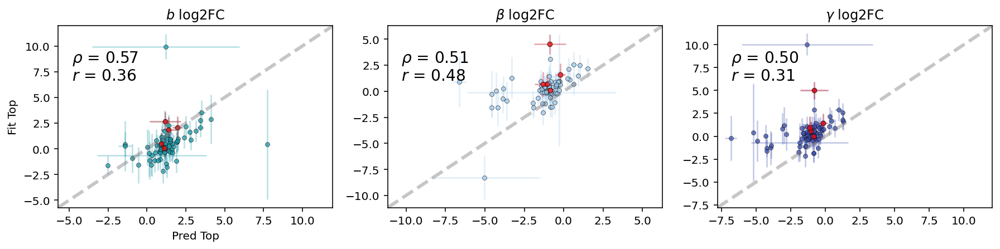

In [58]:

plot_preds_params(z_neg,true_neg,forFilt,std_z_neg,std_true_neg,forFiltSub_top,xlab = 'Pred All', ylab='Fit All',
                  colors=['#A1B2C4','#A1B2C4','#A1B2C4'],subColors=[col_b[0],col_beta[0],col_gamma[0]],
                  figsize=(15,3),alpha=0.5,s=15 )

plot_preds_params(z_neg,true_neg,forFiltSub_top,std_z_neg,std_true_neg,forFiltSub_top&forFiltSub_pmvkFDPS,
                  xlab = 'Pred Top', ylab='Fit Top', 
                  figsize=(15,3),alpha=0.7,s=15)



**Prediction for HUS12a/FDPS2b**

In [263]:
control = 7 #9 for PMVKa/sgFDPSb maybe?, 7 for HUS12a/FDPS2b
#Set results to use
inds = [4,5,3,control] #1,2,0 PMVKa/sgFDPSb  or 4,5,3 HUS12a/FDPS2b
#Neg control inds
inds_neg = [8,10,3,control]  #0 or 3 for both cond

Make gene filters for prediction

n_estimators:  774
Feature prediction accuracy (test size: 20.0%): 0.5526315789473685

Unpredicted labels:  set()
                                              precision    recall  f1-score   support

    replogle_allcrispr_sgHUS1_2a_sgNegCtrl3b       0.49      0.71      0.58        63
replogle_allcrispr_sgNegCtrl02093a_sgFDPS_2b       0.68      0.62      0.65        63
  replogle_allcrispr_sgNegCtrl4a_sgNegCtrl3b       0.51      0.33      0.40        64

                                    accuracy                           0.55       190
                                   macro avg       0.56      0.55      0.54       190
                                weighted avg       0.56      0.55      0.54       190

% literature genes in top predicted: 63.64% 
% literature genes in top predicted: 25.00% 


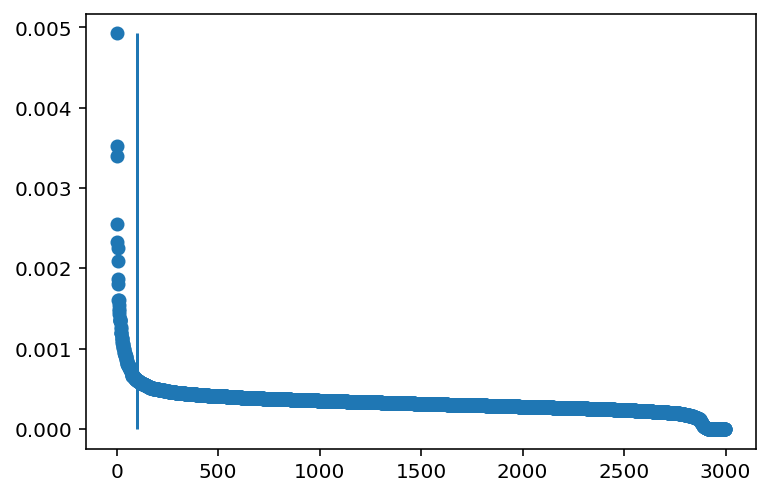

In [264]:
#Make gene filters

cond1_res = sr_arr[inds[0]]  
cond2_res = sr_arr[inds[1]]
both_res = sr_arr[inds[2]]
ctrl_res = sr_arr[inds[-1]]  
  

forFilt = ~cond1_res.rejected_genes & ~cond2_res.rejected_genes & ~ctrl_res.rejected_genes #& ~both_res.rejected_genes
remainAll = cond1_res.gene_names[forFilt]



#Get only DE genes from study, that are not rejected
forFiltSub_husFDPS = forFilt & pd.Categorical(cond1_res.gene_names).isin(names_husFDPS)
remainAllSub = np.array(cond1_res.gene_names)[forFiltSub_husFDPS]


forFiltSub_pmvkFDPS = forFilt & pd.Categorical(cond1_res.gene_names).isin(names_pmvkFDPS)



#Run RF classifier
X,Y = input_for_sel(sd_arr,inds)
top_genes = sel_genes(X,Y, test_size=0.2,n_jobs = 10,num_features = 100)

forFiltSub_top= forFilt & pd.Categorical(cond1_res.gene_names).isin(top_genes)



overlap = np.sum(forFiltSub_top & forFiltSub_husFDPS)/np.sum(forFiltSub_husFDPS)*100
print('% literature genes in top predicted: '+"{:.2f}".format(overlap)+'% ')

overlap = np.sum(forFiltSub_top & forFiltSub_pmvkFDPS)/np.sum(forFiltSub_pmvkFDPS)*100
print('% literature genes in top predicted: '+"{:.2f}".format(overlap)+'% ')

Feature prediction accuracy (test size: 20.0%): 0.4473684210526316

Unpredicted labels:  set()
No. unique genes selected:  95
['replogle_allcrispr_sgHUS1_2a_sgNegCtrl3b'
 'replogle_allcrispr_sgNegCtrl02093a_sgFDPS_2b'
 'replogle_allcrispr_sgNegCtrl4a_sgNegCtrl3b']


/home/tchari/miniconda3/envs/py37/lib/python3.7/site-packages/sklearn/linear_model/_logistic.py:818: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG,


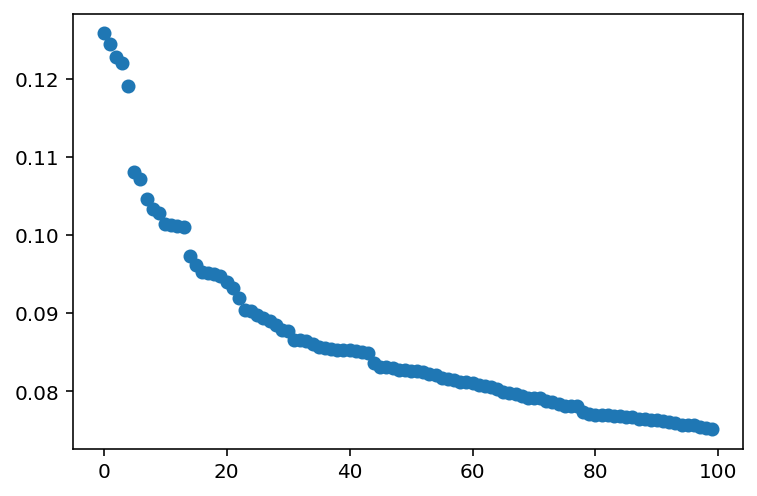

In [231]:
top_genes = sel_logreg_genes(X,Y)
forFiltSub_top= forFilt & pd.Categorical(cond1_res.gene_names).isin(top_genes)


Predictions

In [265]:
z,true  = pred_params(par_vals,inds,model='mult')
std_z, std_true = pred_stds(par_vals,inds,ctrlInds,model='mult')

In [266]:
z_neg,true_neg  = pred_params(par_vals,inds_neg,model='mult')
std_z_neg, std_true_neg = pred_stds(par_vals,inds_neg,ctrlInds,model='mult')

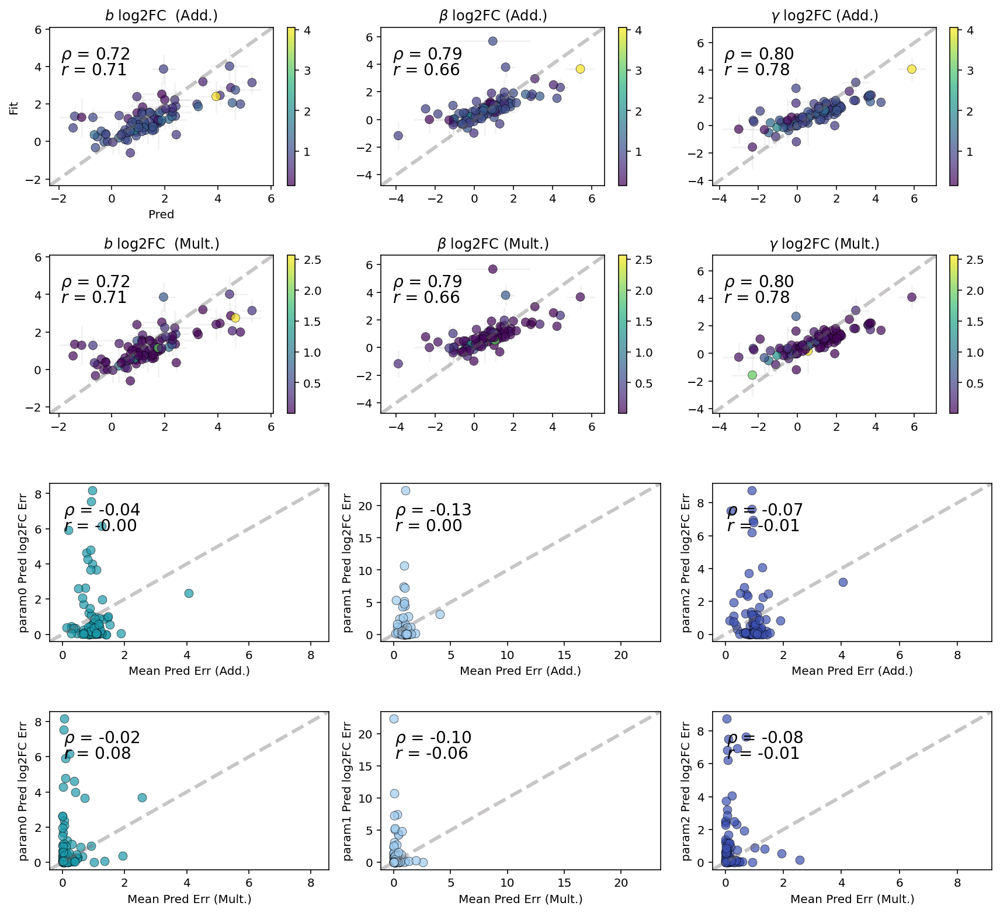

In [267]:
plot_preds_multAdd(z,true,forFiltSub_top,std_z,std_true,sd_arr,inds,mod=1,s=55,figsize=(12,11))

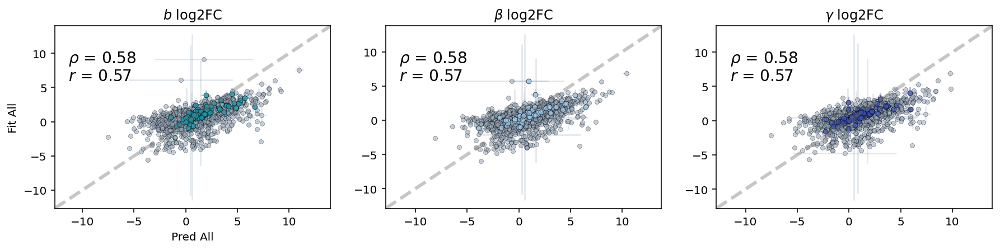

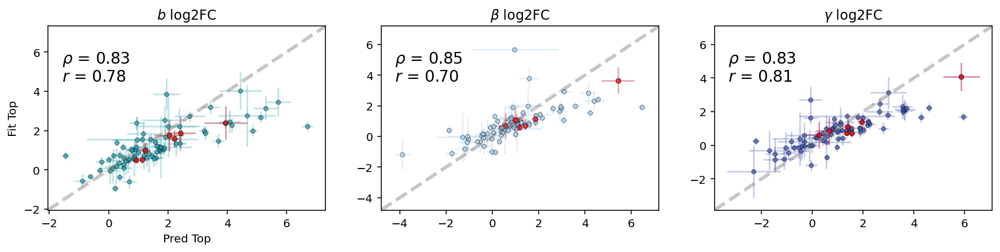

In [73]:

plot_preds_params(z,true,forFilt,std_z,std_true,forFiltSub_top,xlab = 'Pred All', ylab='Fit All',
                  colors=['#A1B2C4','#A1B2C4','#A1B2C4'],subColors=[col_b[0],col_beta[0],col_gamma[0]],
                  figsize=(15,3),alpha=0.5,s=15 )

plot_preds_params(z,true,forFiltSub_top,std_z,std_true,forFiltSub_top&forFiltSub_husFDPS,
                  xlab = 'Pred Top', ylab='Fit Top', 
                  figsize=(15,3),alpha=0.7,s=15)



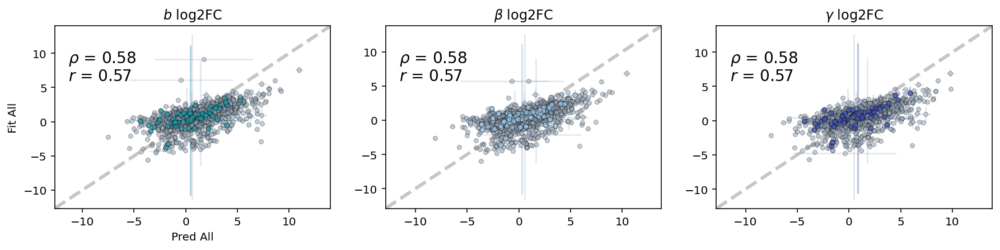

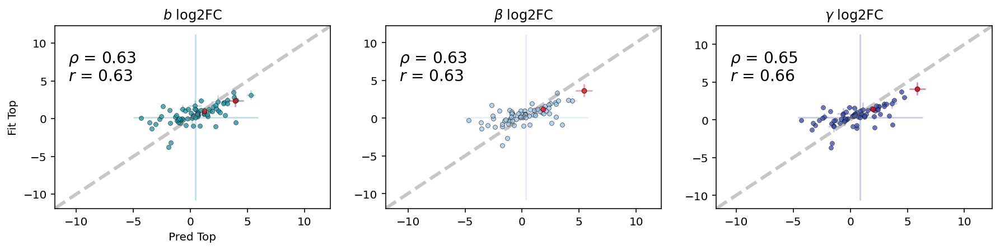

In [234]:
#logreg

plot_preds_params(z,true,forFilt,std_z,std_true,forFiltSub_top,xlab = 'Pred All', ylab='Fit All',
                  colors=['#A1B2C4','#A1B2C4','#A1B2C4'],subColors=[col_b[0],col_beta[0],col_gamma[0]],
                  figsize=(15,3),alpha=0.5,s=15 )

plot_preds_params(z,true,forFiltSub_top,std_z,std_true,forFiltSub_top&forFiltSub_husFDPS,
                  xlab = 'Pred Top', ylab='Fit Top', 
                  figsize=(15,3),alpha=0.7,s=15)



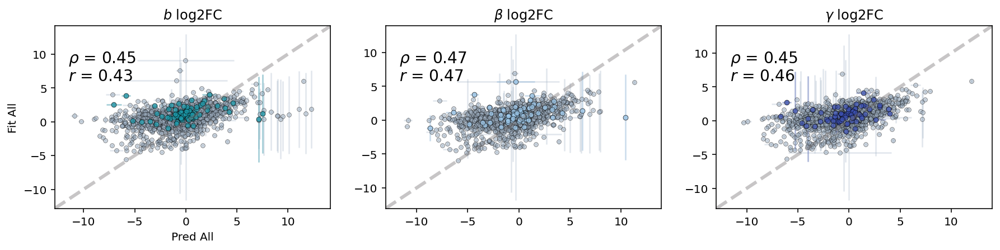

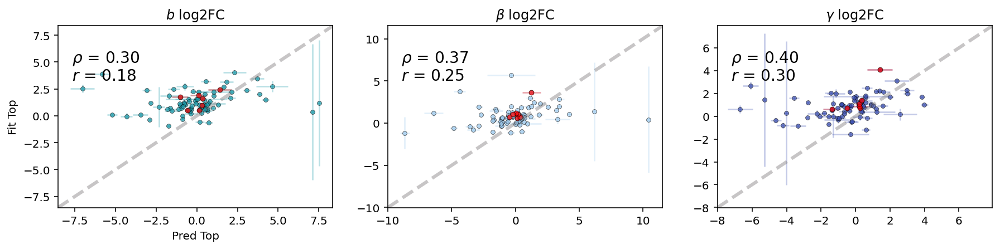

In [74]:

plot_preds_params(z_neg,true_neg,forFilt,std_z_neg,std_true_neg,forFiltSub_top,xlab = 'Pred All', ylab='Fit All',
                  colors=['#A1B2C4','#A1B2C4','#A1B2C4'],subColors=[col_b[0],col_beta[0],col_gamma[0]],
                  figsize=(15,3),alpha=0.5,s=15 )

plot_preds_params(z_neg,true_neg,forFiltSub_top,std_z_neg,std_true_neg,forFiltSub_top&forFiltSub_husFDPS,
                  xlab = 'Pred Top', ylab='Fit Top', 
                  figsize=(15,3),alpha=0.7,s=15)



In [268]:
z,true  = pred_params(par_vals,inds,model='add')
std_z, std_true = pred_stds(par_vals,inds,ctrlInds,model='add')

In [269]:
z_neg,true_neg  = pred_params(par_vals,inds_neg,model='add')
std_z_neg, std_true_neg = pred_stds(par_vals,inds_neg,ctrlInds,model='add')

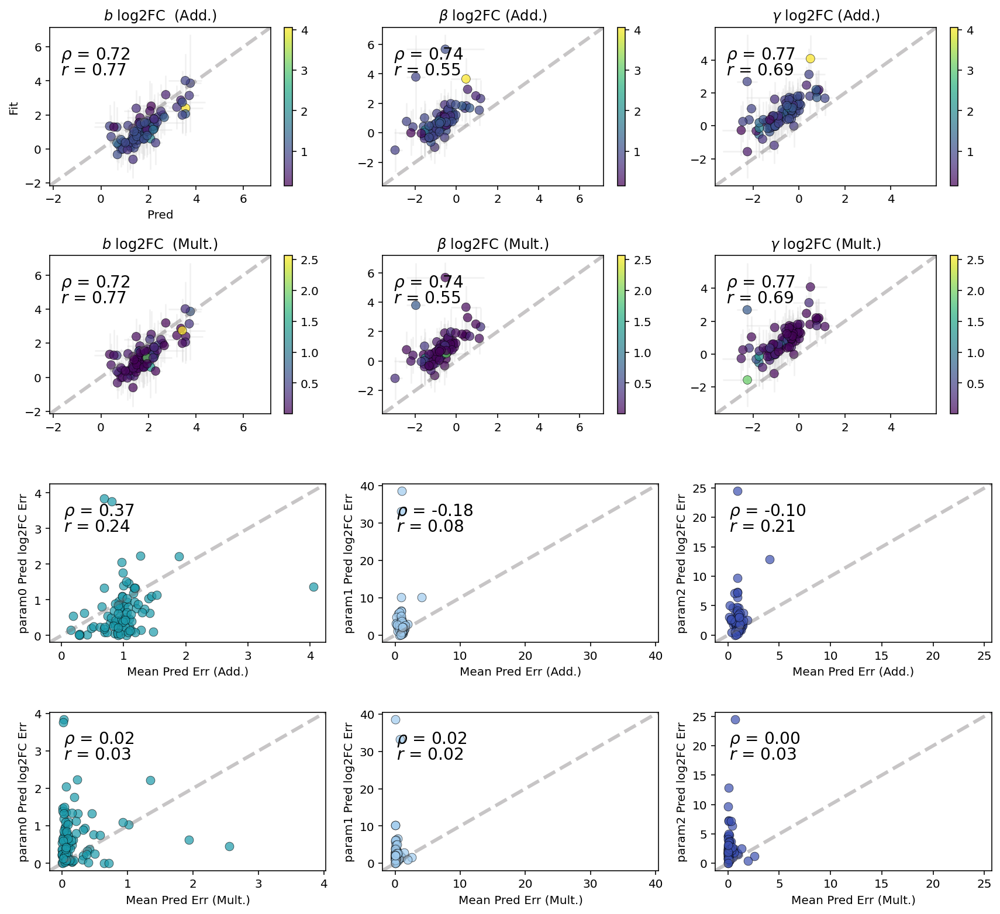

In [270]:
plot_preds_multAdd(z,true,forFiltSub_top,std_z,std_true,sd_arr,inds,mod=1,s=55,figsize=(12,11))

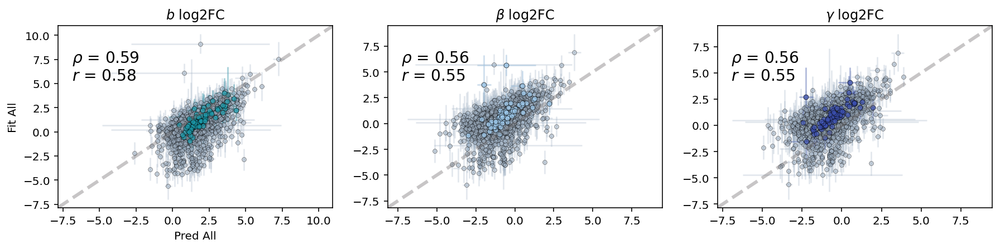

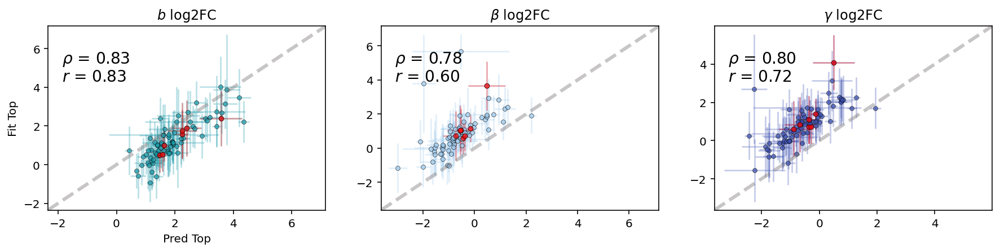

In [77]:

plot_preds_params(z,true,forFilt,std_z,std_true,forFiltSub_top,xlab = 'Pred All', ylab='Fit All',
                  colors=['#A1B2C4','#A1B2C4','#A1B2C4'],subColors=[col_b[0],col_beta[0],col_gamma[0]],
                  figsize=(15,3),alpha=0.5,s=15 )

plot_preds_params(z,true,forFiltSub_top,std_z,std_true,forFiltSub_top&forFiltSub_husFDPS,
                  xlab = 'Pred Top', ylab='Fit Top', 
                  figsize=(15,3),alpha=0.7,s=15)



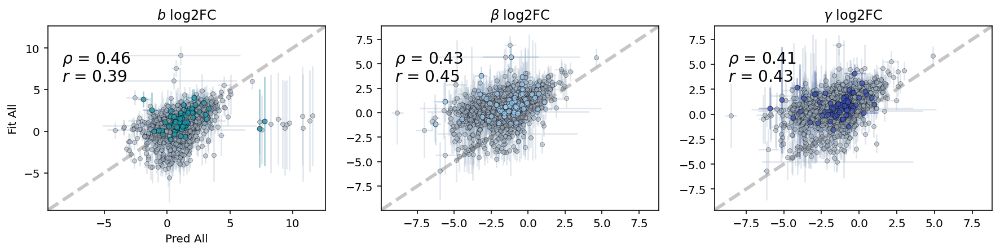

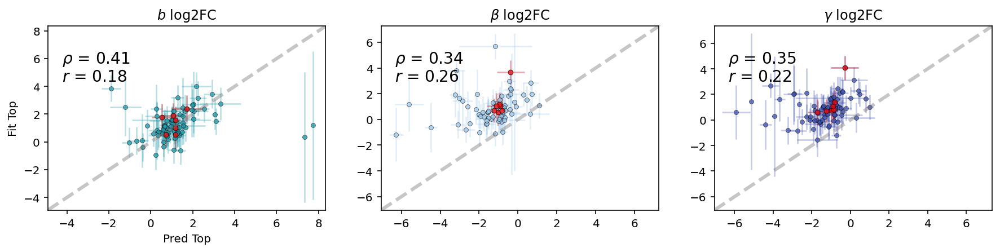

In [78]:

plot_preds_params(z_neg,true_neg,forFilt,std_z_neg,std_true_neg,forFiltSub_top,xlab = 'Pred All', ylab='Fit All',
                  colors=['#A1B2C4','#A1B2C4','#A1B2C4'],subColors=[col_b[0],col_beta[0],col_gamma[0]],
                  figsize=(15,3),alpha=0.5,s=15 )

plot_preds_params(z_neg,true_neg,forFiltSub_top,std_z_neg,std_true_neg,forFiltSub_top&forFiltSub_husFDPS,
                  xlab = 'Pred Top', ylab='Fit Top', 
                  figsize=(15,3),alpha=0.7,s=15)



### **Check additive/multiplicative at S-level**

In [122]:
def plotComparisons(par_vals,sd_arr,inds,filt, xlab = 'Spliced', ylab='Parameter', figsize=(5,5),alpha=0.7,s=5,corr=True,fs=14 ):
    fig, axs = plt.subplots(3, 5,figsize=figsize)
    
    ns = [r'$b$',r'$\beta$',r'$\gamma$',r'$b/\gamma$']
    for i in range(3): #parameter, b,beta,gamma
        for j in range(3): #cond1,2,and 1,2
            spliced = np.log10(np.mean(sd_arr[inds[j]].layers[0,filt,:],axis=1)/np.mean(sd_arr[inds[-1]].layers[0,filt,:],axis=1))
            params = par_vals[1,inds[j],filt,i] -par_vals[1,inds[-1],filt,i]
            
            axs[i,j].scatter(spliced,params,alpha=alpha,s=s)
            rho = np.corrcoef(spliced,params)[0][1]
            if corr:
                axs[i,j].text(.05,.8,r'$r$ = {:.2f}'.format(rho),fontsize=fs,transform=axs[i,j].transAxes)

            
            axs[i,j].set_xlabel(r'log($\mu_S$)')
            axs[i,j].set_ylabel(ns[i])
            
            if i==0:
                axs[i,j].set_title('Cond'+str(j+1))
                
    #fourth col is corr of mult FC
    for i in range(3):
            j = 3
            
            spliced = np.log10(np.mean(sd_arr[inds[0]].layers[0,filt,:],axis=1))-np.log10(np.mean(sd_arr[inds[-1]].layers[0,filt,:],axis=1))+np.log10(np.mean(sd_arr[inds[1]].layers[0,filt,:],axis=1))-np.log10(np.mean(sd_arr[inds[-1]].layers[0,filt,:],axis=1))
            params = par_vals[1,inds[0],filt,i]-par_vals[1,inds[-1],filt,i] + par_vals[1,inds[1],filt,i]-par_vals[1,inds[-1],filt,i]

            spliced = np.log2(10**spliced)
            params = np.log2(10**params)
            
            axs[i,j].scatter(spliced,params,alpha=alpha,s=s)
            rho = np.corrcoef(spliced,params)[0][1]
            if corr:
                axs[i,j].text(.05,.8,r'$r$ = {:.2f}'.format(rho),fontsize=fs,transform=axs[i,j].transAxes)

            
            axs[i,j].set_xlabel(r'Pred $\mu{S}_{1,2}$ log2FC')
            axs[i,j].set_ylabel('Pred'+ns[i]+r'$_{1,2} log2FC$')
            
    #S fc vs U fc
    for i in range(3):
            j = 4
            
            unspliced = np.log10(np.mean(sd_arr[inds[0]].layers[0,filt,:],axis=1))-np.log10(np.mean(sd_arr[inds[-1]].layers[0,filt,:],axis=1))+np.log10(np.mean(sd_arr[inds[1]].layers[0,filt,:],axis=1))-np.log10(np.mean(sd_arr[inds[-1]].layers[0,filt,:],axis=1))
            spliced = np.log10(np.mean(sd_arr[inds[0]].layers[1,filt,:],axis=1))-np.log10(np.mean(sd_arr[inds[-1]].layers[1,filt,:],axis=1))+np.log10(np.mean(sd_arr[inds[1]].layers[1,filt,:],axis=1))-np.log10(np.mean(sd_arr[inds[-1]].layers[1,filt,:],axis=1))

            spliced = np.log2(10**spliced)
            unspliced = np.log2(10**unspliced)
            
            axs[i,j].scatter(spliced,unspliced,alpha=alpha,s=s)
            rho = np.corrcoef(spliced,unspliced)[0][1]
            if corr:
                axs[i,j].text(.05,.8,r'$r$ = {:.2f}'.format(rho),fontsize=fs,transform=axs[i,j].transAxes)

            
            axs[i,j].set_xlabel(r'Pred $\mu{S}_{1,2}$ log2FC')
            axs[i,j].set_ylabel(r'Pred $\mu{U}_{1,2}$ log2FC')
            
    

    

In [123]:
def plotVars(par_vals,err_mat,sd_arr,inds,filt,filtIntraSub, xlab = 'Spliced', ylab='Parameter', figsize=(5,5),alpha=0.7,s=5,corr=True,fs=14 ):
    fig, axs = plt.subplots(6, 3,figsize=figsize)
    
    ns = [r'$b$',r'$\beta$',r'$\gamma$',r'$b/\gamma$']
    genes = np.array(range(par_vals[1,inds[0],:,:].shape[0]))
    
    for i in range(3): #parameter, b,beta,gamma
        #Variances
        stds = err_mat[:,i]
        stds_sub = err_mat[filtIntraSub,i]
        
        indices = np.argsort(stds)[::-1]
        indices_sub = np.argsort(stds_sub)[::-1]
      
        sub_inds = np.array(range(err_mat.shape[0]))[filtIntraSub]
        
        maps = [np.where(np.array(range(err_mat.shape[0]))[indices] == x) for x in sub_inds[indices_sub]]
        

        axs[0,i].scatter(range(err_mat.shape[0]),stds[indices],alpha=alpha,s=s,color='grey')
        axs[0,i].scatter(maps,stds_sub[indices_sub],alpha=alpha,s=s,color='red')


        axs[0,i].set_xlabel(r'Gene')
        axs[0,i].set_ylabel(ns[i]+' Std.')

        if i==0:
            axs[0,i].set_title('Prediction Std Devs')
            
    for i in range(3): #parameter, b,beta,gamma
        #FCs
        
        params = par_vals[1,inds[0],:,i]-par_vals[1,inds[-1],:,i] + par_vals[1,inds[1],:,i]-par_vals[1,inds[-1],:,i]
        params = np.log2(10**params)
        params_sub = params[filtIntraSub]
   
        indices = np.argsort(params)[::-1]
        indices_sub = np.argsort(params_sub)[::-1]
      
        sub_inds = np.array(range(params.shape[0]))[filtIntraSub]
        
        maps = [np.where(np.array(range(params.shape[0]))[indices] == x) for x in sub_inds[indices_sub]]
        

        axs[1,i].scatter(range(params.shape[0]),params[indices],alpha=alpha,s=s,color='grey')
        axs[1,i].scatter(maps,params_sub[indices_sub],alpha=alpha,s=s,color='red')


        axs[1,i].set_xlabel(r'Gene')
        axs[1,i].set_ylabel(ns[i]+' Pred FC')

        if i==0:
            axs[1,i].set_title('Prediction log2FC')
            
            
    for i in range(3): #parameter, b,beta,gamma
        #FCs
        
        params = par_vals[1,inds[2],:,i]-par_vals[1,inds[-1],:,i]
        params = np.log2(10**params)
        params_sub = params[filtIntraSub]
   
        indices = np.argsort(params)[::-1]
        indices_sub = np.argsort(params_sub)[::-1]
      
        sub_inds = np.array(range(params.shape[0]))[filtIntraSub]
        
        maps = [np.where(np.array(range(params.shape[0]))[indices] == x) for x in sub_inds[indices_sub]]
        

        axs[2,i].scatter(range(params.shape[0]),params[indices],alpha=alpha,s=s,color='grey')
        axs[2,i].scatter(maps,params_sub[indices_sub],alpha=alpha,s=s,color='red')


        axs[2,i].set_xlabel(r'Gene')
        axs[2,i].set_ylabel(ns[i]+' Fit FC')

        if i==0:
            axs[2,i].set_title('Fit log2FC')
            
            
    for i in range(3): #parameter, cond1,2,3 FANO factor
        #FCs
        
        spliced = (np.var(sd_arr[inds[i]].layers[1,:,:],axis=1))/(np.mean(sd_arr[inds[i]].layers[1,:,:],axis=1)) #-np.log10(np.mean(sd_arr[-1].layers[1,filt,:],axis=1))
        spliced_sub = spliced[filtIntraSub]
   
        indices = np.argsort(spliced)[::-1]
        indices_sub = np.argsort(spliced_sub)[::-1]
      
        sub_inds = np.array(range(spliced.shape[0]))[filtIntraSub]
        
        maps = [np.where(np.array(range(spliced.shape[0]))[indices] == x) for x in sub_inds[indices_sub]]
        

        axs[3,i].scatter(range(spliced.shape[0]),spliced[indices],alpha=alpha,s=s,color='grey')
        axs[3,i].scatter(maps,spliced_sub[indices_sub],alpha=alpha,s=s,color='red')


        axs[3,i].set_xlabel(r'Gene')
        axs[3,i].set_ylabel('S Fano')

        if i==0:
            axs[3,i].set_title('S Fano')
            
    for i in range(3): #parameter, b,beta,gamma
        #FCs
        
        params = par_vals[1,inds[i],:,0]-par_vals[1,inds[i],:,2] - (par_vals[1,inds[-1],:,0]-par_vals[1,inds[-1],:,2] )
        #params += (par_vals[1,inds[1],:,0]-par_vals[1,inds[1],:,2] - (par_vals[1,inds[-1],:,0]-par_vals[1,inds[-1],:,2] ))
        params = np.log2(10**params)
        params_sub = params[filtIntraSub]
   
        indices = np.argsort(params)[::-1]
        indices_sub = np.argsort(params_sub)[::-1]
        
        print(np.min(np.abs(params_sub)))
      
        sub_inds = np.array(range(params.shape[0]))[filtIntraSub]
        
        maps = [np.where(np.array(range(params.shape[0]))[indices] == x) for x in sub_inds[indices_sub]]
        

        axs[4,i].scatter(range(params.shape[0]),params[indices],alpha=alpha,s=s,color='grey')
        axs[4,i].scatter(maps,params_sub[indices_sub],alpha=alpha,s=s,color='red')


        axs[4,i].set_xlabel(r'Gene')
        axs[4,i].set_ylabel('Cond'+str(i)+'Fit Approx S FC')

        if i==0:
            axs[4,i].set_title('Fit Approx S log2FC')
            
    
    for i in range(3): #parameter, b,beta,gamma
        #FCs
        
        params = par_vals[1,inds[0],:,0]-par_vals[1,inds[0],:,2] - (par_vals[1,inds[-1],:,0]-par_vals[1,inds[-1],:,2] )
        #params += (par_vals[1,inds[1],:,0]-par_vals[1,inds[1],:,2] - (par_vals[1,inds[-1],:,0]-par_vals[1,inds[-1],:,2] ))
        params = np.log2(10**params)
        params_sub = params[filtIntraSub]
        
        
        params2 = par_vals[1,inds[1],:,0]-par_vals[1,inds[1],:,2] - (par_vals[1,inds[-1],:,0]-par_vals[1,inds[-1],:,2] )
        #params += (par_vals[1,inds[1],:,0]-par_vals[1,inds[1],:,2] - (par_vals[1,inds[-1],:,0]-par_vals[1,inds[-1],:,2] ))
        params2 = np.log2(10**params2)
        params_sub2 = params2[filtIntraSub]
   
      
        
        axs[5,i].scatter(params,params2,alpha=alpha,s=s)
        axs[5,i].scatter(params_sub,params_sub2,alpha=alpha,s=s,color='red')
        rho = np.corrcoef(params,params2)[0][1]
        rho2 = np.corrcoef(params_sub,params_sub2)[0][1]
        if corr:
            axs[5,i].text(.05,.8,r'$r$ = {:.2f}'.format(rho),fontsize=fs,transform=axs[5,i].transAxes)
            axs[5,i].text(.05,.7,r'$r_s$ = {:.2f}'.format(rho2),fontsize=fs,transform=axs[5,i].transAxes)


        axs[5,i].set_xlabel(r'Pred $\mu{S}_{1}$ log2FC')
        axs[5,i].set_ylabel(r'Pred $\mu{S}_{2}$ log2FC')
        
        axs[5,i].plot(params2,params2,color='grey',linestyle='--')
        axs[5,i].plot(params2,-1*params2,color='grey',linestyle='--')

        if i==0:
            axs[5,i].set_title('Fit Approx S log2FC')
            




    

In [124]:
def plotLitProps(par_vals,sd_arr,inds,filt,filtSub, xlab = 'Spliced', ylab='Parameter', figsize=(5,5),alpha=0.7,s=5,corr=True,fs=14): #Plot properties of literature genes on top of others

    #Plot spliced, unspliced counts per gene, U/S ratio, var in params over ctrls, 
    
    fig, axs = plt.subplots(3, 4,figsize=figsize)
    genes = np.array(range(par_vals[1,inds[0],:,:].shape[0]))
    
    for i in range(3): #cond1 and 2
        spliced = np.log10(np.mean(sd_arr[inds[i]].layers[1,filt,:],axis=1))
        splicedSub = np.log10(np.mean(sd_arr[inds[i]].layers[1,filtSub,:],axis=1))
        
        filt_genes = genes[filt]
        filt_genes_sub = genes[filtSub]
        
        indices = np.argsort(spliced)[::-1]
        indices_sub = np.argsort(splicedSub)[::-1]
        
        #which filt genes sorted
        maps = [np.where(filt_genes[indices] == x) for x in filt_genes_sub[indices_sub]]
        
        
        axs[i,0].scatter(range(len(indices)),spliced[indices],alpha=alpha,s=s,color='grey')
        axs[i,0].scatter(maps,splicedSub[indices_sub],alpha=alpha,s=s*1.5,color='red')
        axs[i,0].set_xlabel(r'Gene')
        axs[i,0].set_ylabel(r'log10(S)')
        
        
        unspliced = np.log10(np.mean(sd_arr[inds[i]].layers[0,filt,:],axis=1))
        unsplicedSub = np.log10(np.mean(sd_arr[inds[i]].layers[0,filtSub,:],axis=1))
        indices = np.argsort(unspliced)[::-1]
        indices_sub = np.argsort(unsplicedSub)[::-1]
        maps = [np.where(filt_genes[indices] == x) for x in filt_genes_sub[indices_sub]]
        
        
        
        axs[i,1].scatter(range(len(indices)),unspliced[indices],alpha=alpha,s=s,color='grey')
        axs[i,1].scatter(maps,unsplicedSub[indices_sub],alpha=alpha,s=s*1.5,color='red')
        axs[i,1].set_xlabel(r'Gene')
        axs[i,1].set_ylabel(r'log10(U)')

        
        indices = np.argsort(spliced-unspliced)[::-1]
        indices_sub = np.argsort(splicedSub-unsplicedSub)[::-1]
        maps = [np.where(filt_genes[indices] == x) for x in filt_genes_sub[indices_sub]]
        

        axs[i,2].scatter(range(len(indices)),(spliced-unspliced)[indices],alpha=alpha,s=s,color='grey')
        axs[i,2].scatter(maps,(splicedSub-unsplicedSub)[indices_sub],alpha=alpha,s=s*1.5,color='red')
        axs[i,2].set_xlabel(r'Gene')
        axs[i,2].set_ylabel(r'log10(S/U)')
        
        
        
        
        indices = np.argsort(10**spliced+10**unspliced)[::-1]
        indices_sub = np.argsort(10**splicedSub+10**unsplicedSub)[::-1]
        maps = [np.where(filt_genes[indices] == x) for x in filt_genes_sub[indices_sub]]
        
        

        axs[i,3].scatter(range(len(indices)),np.log10(10**spliced+10**unspliced)[indices],alpha=alpha,s=s,color='grey')
        axs[i,3].scatter(maps,np.log10(10**splicedSub+10**unsplicedSub)[indices_sub],alpha=alpha,s=s*1.5,color='red')
        axs[i,3].set_xlabel(r'Gene')
        axs[i,3].set_ylabel(r'log10(S+U)')
        
        

    
    

n_estimators:  774
Feature prediction accuracy (test size: 20.0%): 0.45549738219895286

Unpredicted labels:  set()
                                            precision    recall  f1-score   support

replogle_allcrispr_sgNegCtrl02093a_sgFDPSb       0.51      0.48      0.49        63
replogle_allcrispr_sgNegCtrl5a_sgNegCtrl3b       0.42      0.53      0.47        64
    replogle_allcrispr_sgPMVKa_sgNegCtrl3b       0.45      0.36      0.40        64

                                  accuracy                           0.46       191
                                 macro avg       0.46      0.46      0.45       191
                              weighted avg       0.46      0.46      0.45       191



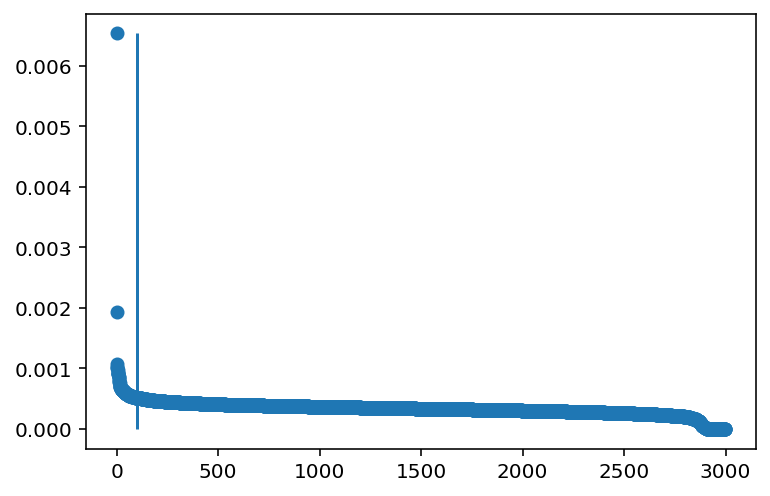

In [251]:
inds = [1, 2, 0, 9]
cond1_res = sr_arr[inds[0]]  
cond2_res = sr_arr[inds[1]]
both_res = sr_arr[inds[2]]
ctrl_res = sr_arr[inds[3]]  

forFilt = ~cond1_res.rejected_genes & ~cond2_res.rejected_genes & ~ctrl_res.rejected_genes #& s_filt
remainAll = cond1_res.gene_names[forFilt]


#Run RF classifier
X,Y = input_for_sel(sd_arr,inds)
top_genes = sel_genes(X,Y, test_size=0.2,n_jobs = 10,num_features = 100)

forFiltSub_top= forFilt & pd.Categorical(cond1_res.gene_names).isin(top_genes)


# top_genes = sel_logreg_genes(X,Y,clf_inds=[0,2])
# forFiltSub_top= forFilt & pd.Categorical(cond1_res.gene_names).isin(top_genes)



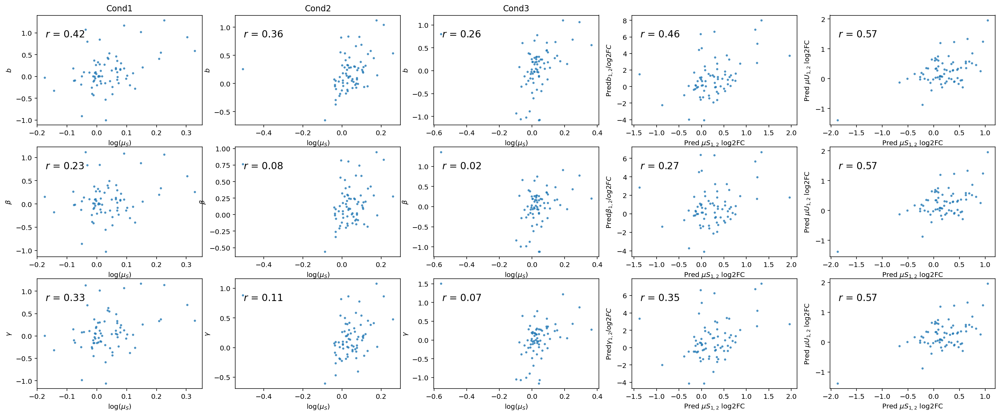

In [241]:
plotComparisons(par_vals,sd_arr,inds,forFiltSub_top, xlab = 'Spliced', ylab='Parameter', figsize=(25,10),alpha=0.7 )



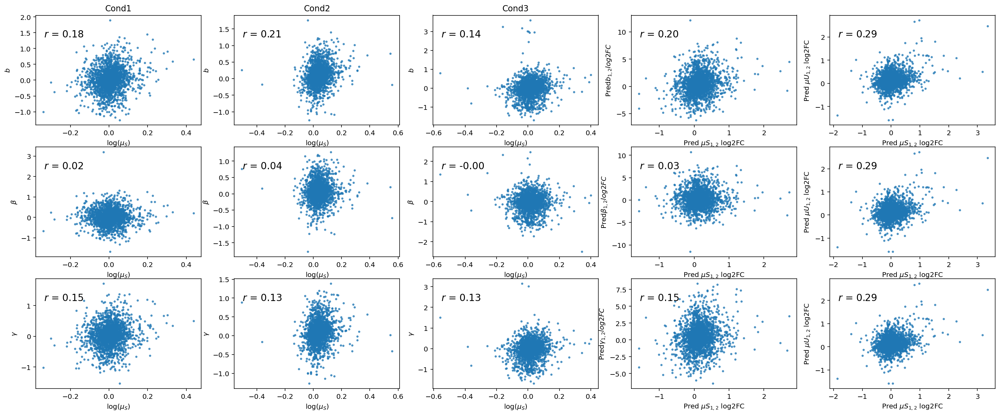

In [242]:
plotComparisons(par_vals,sd_arr,inds,forFilt, xlab = 'Spliced', ylab='Parameter', figsize=(25,10),alpha=0.7 )



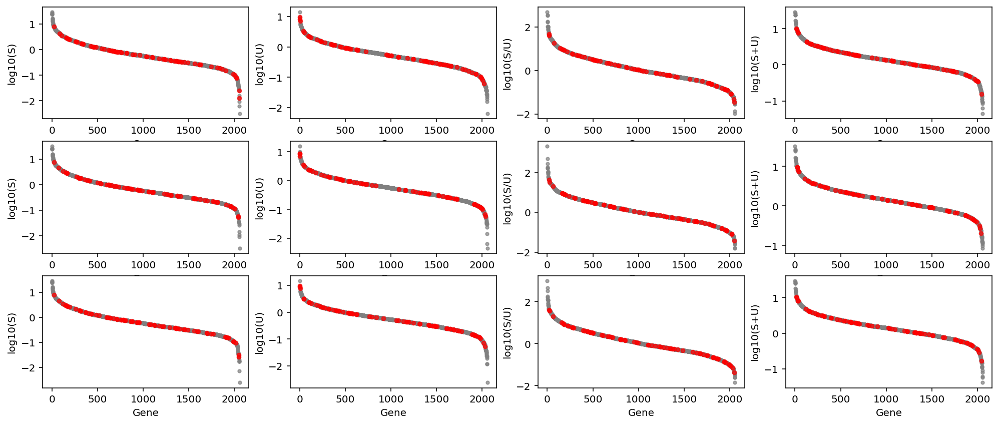

In [243]:
plotLitProps(par_vals,sd_arr,inds,forFilt,forFiltSub_top, xlab = 'Spliced', ylab='Parameter', figsize=(17,7),alpha=0.7,s=10)


/home/tchari/.local/lib/python3.7/site-packages/ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


0.00299554715102355
0.00046886507470660506
0.0013696099379916814


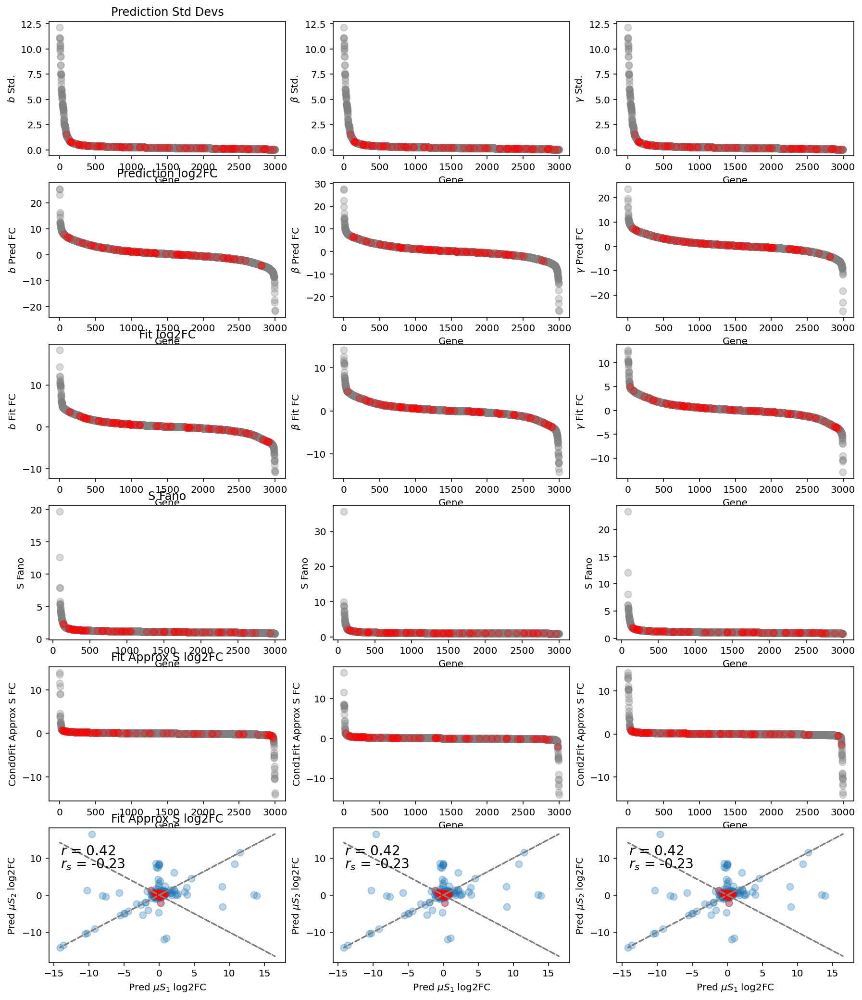

In [244]:
plotVars(par_vals,std_z,sd_arr,inds,forFilt,forFiltSub_top, xlab = 'Spliced', ylab='Parameter', figsize=(15,18),alpha=0.3,s=50,corr=True,fs=14 )



In [203]:
guess = np.mean(sd_arr[inds[0]].layers[1][forFilt,:],axis=1)/np.mean(sd_arr[inds[-1]].layers[1][forFilt,:],axis=1) + np.mean(sd_arr[inds[1]].layers[1][forFilt,:],axis=1)/np.mean(sd_arr[inds[-1]].layers[1][forFilt,:],axis=1)

true_vals = np.mean(sd_arr[inds[2]].layers[1][forFilt,:],axis=1)/np.mean(sd_arr[inds[-1]].layers[1][forFilt,:],axis=1)


[[1.        0.5509774]
 [0.5509774 1.       ]]
0.48121867830471765


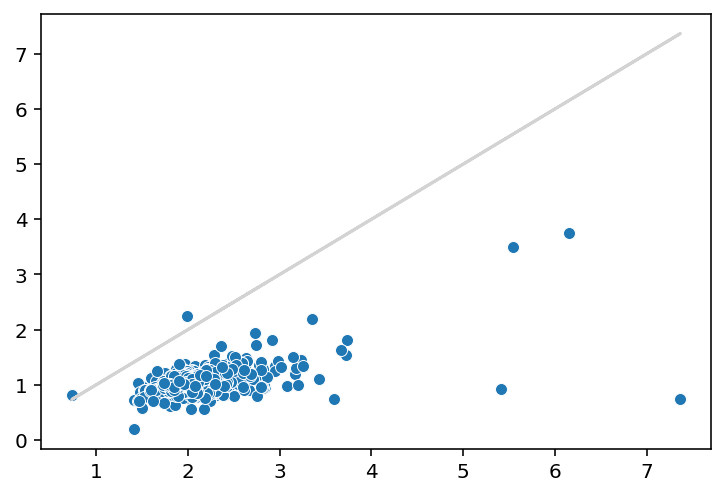

In [205]:
sns.scatterplot(x=guess,y=true_vals)
plt.plot(guess,guess,color='lightgrey')
print(np.corrcoef(guess,true_vals))
print(scipy.stats.spearmanr(guess,true_vals)[0])

In [206]:
guess = np.log2(np.mean(sd_arr[inds[0]].layers[1][forFilt,:],axis=1)/np.mean(sd_arr[inds[-1]].layers[1][forFilt,:],axis=1))+np.log2(np.mean(sd_arr[inds[1]].layers[1][forFilt,:],axis=1)/np.mean(sd_arr[inds[-1]].layers[1][forFilt,:],axis=1))

true_vals = np.log2(np.mean(sd_arr[inds[2]].layers[1][forFilt,:],axis=1)/np.mean(sd_arr[inds[-1]].layers[1][forFilt,:],axis=1))


[[1.         0.52740511]
 [0.52740511 1.        ]]
0.4804216885333833


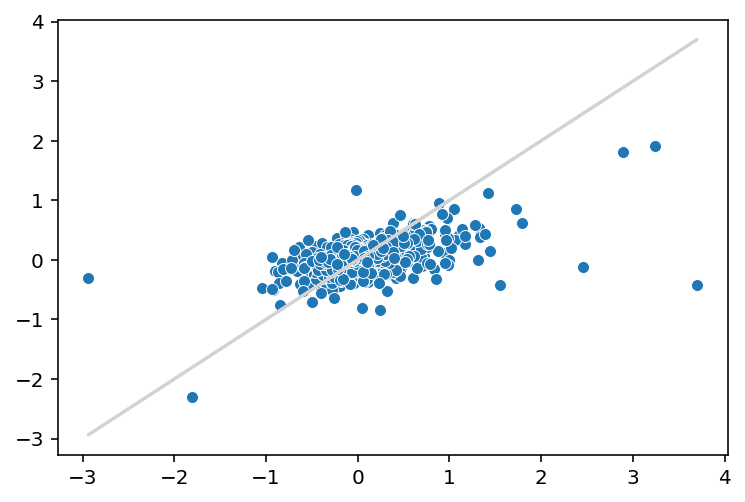

In [207]:
sns.scatterplot(x=guess,y=true_vals)
plt.plot(guess,guess,color='lightgrey')
print(np.corrcoef(guess,true_vals))
print(scipy.stats.spearmanr(guess,true_vals)[0])

n_estimators:  774
Feature prediction accuracy (test size: 20.0%): 0.531578947368421

Unpredicted labels:  set()
                                              precision    recall  f1-score   support

    replogle_allcrispr_sgHUS1_2a_sgNegCtrl3b       0.46      0.70      0.56        63
replogle_allcrispr_sgNegCtrl02093a_sgFDPS_2b       0.63      0.57      0.60        63
  replogle_allcrispr_sgNegCtrl4a_sgNegCtrl3b       0.55      0.33      0.41        64

                                    accuracy                           0.53       190
                                   macro avg       0.55      0.53      0.52       190
                                weighted avg       0.55      0.53      0.52       190



/home/tchari/miniconda3/envs/py37/lib/python3.7/site-packages/sklearn/linear_model/_logistic.py:818: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG,


Feature prediction accuracy (test size: 20.0%): 0.41578947368421054

Unpredicted labels:  set()
No. unique genes selected:  96
['replogle_allcrispr_sgHUS1_2a_sgNegCtrl3b'
 'replogle_allcrispr_sgNegCtrl02093a_sgFDPS_2b'
 'replogle_allcrispr_sgNegCtrl4a_sgNegCtrl3b']


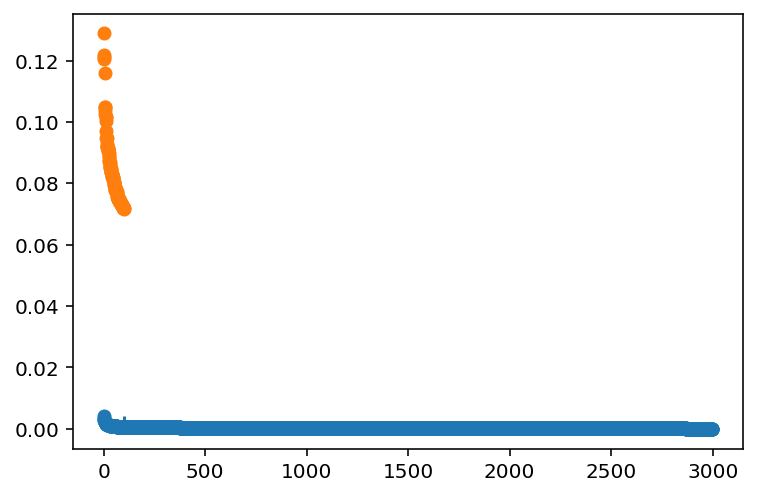

In [245]:
inds = [4,5,3, 7]
cond1_res = sr_arr[inds[0]]  
cond2_res = sr_arr[inds[1]]
both_res = sr_arr[inds[2]]
ctrl_res = sr_arr[inds[3]]  

forFilt = ~cond1_res.rejected_genes & ~cond2_res.rejected_genes & ~ctrl_res.rejected_genes #& s_filt
remainAll = cond1_res.gene_names[forFilt]


#Run RF classifier
X,Y = input_for_sel(sd_arr,inds)
top_genes = sel_genes(X,Y, test_size=0.2,n_jobs = 10,num_features = 100)

forFiltSub_top= forFilt & pd.Categorical(cond1_res.gene_names).isin(top_genes)

top_genes = sel_logreg_genes(X,Y)
forFiltSub_top= forFilt & pd.Categorical(cond1_res.gene_names).isin(top_genes)



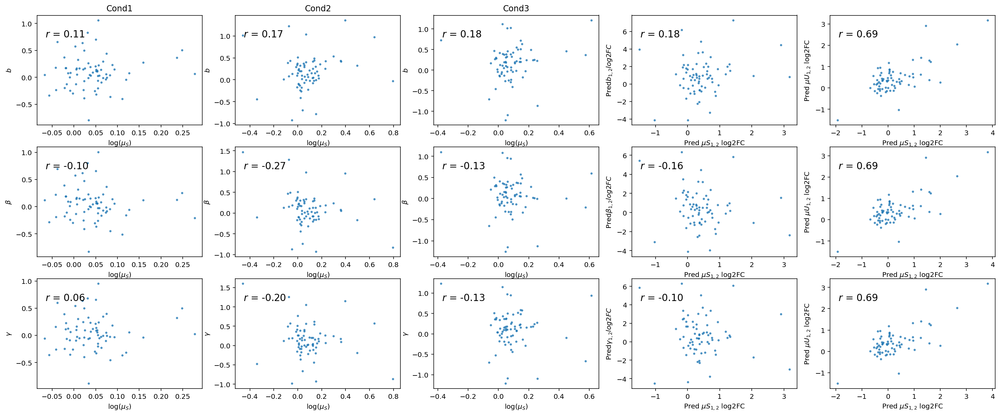

In [246]:
plotComparisons(par_vals,sd_arr,inds,forFiltSub_top, xlab = 'Spliced', ylab='Parameter', figsize=(25,10),alpha=0.7 )



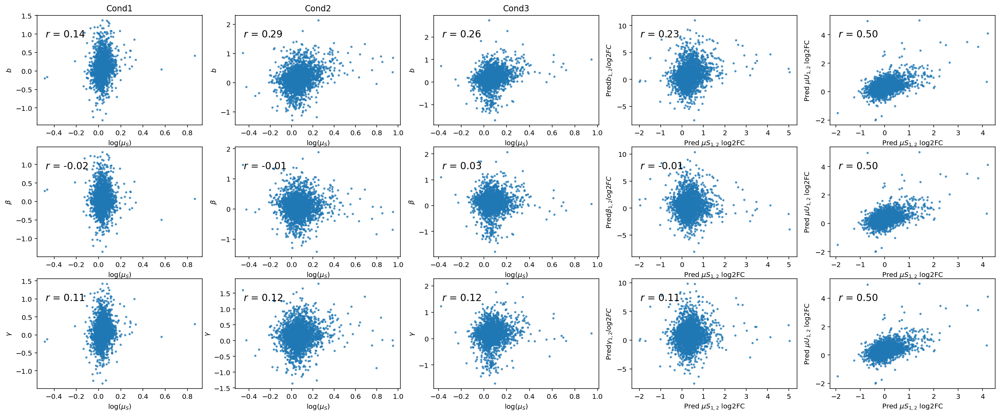

In [247]:
plotComparisons(par_vals,sd_arr,inds,forFilt, xlab = 'Spliced', ylab='Parameter', figsize=(25,10),alpha=0.7 )



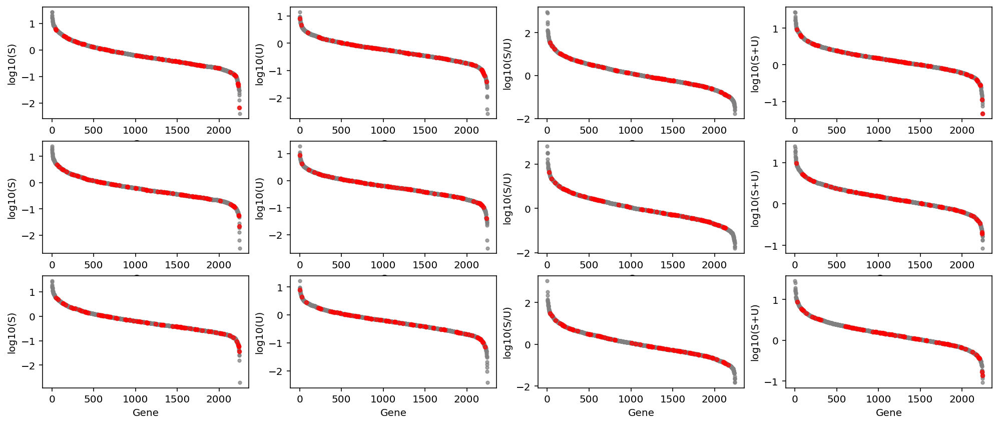

In [248]:
plotLitProps(par_vals,sd_arr,inds,forFilt,forFiltSub_top, xlab = 'Spliced', ylab='Parameter', figsize=(17,7),alpha=0.7,s=10)


/home/tchari/.local/lib/python3.7/site-packages/ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


0.003004072519758584
0.0028456805204349206
0.00031503077970993686


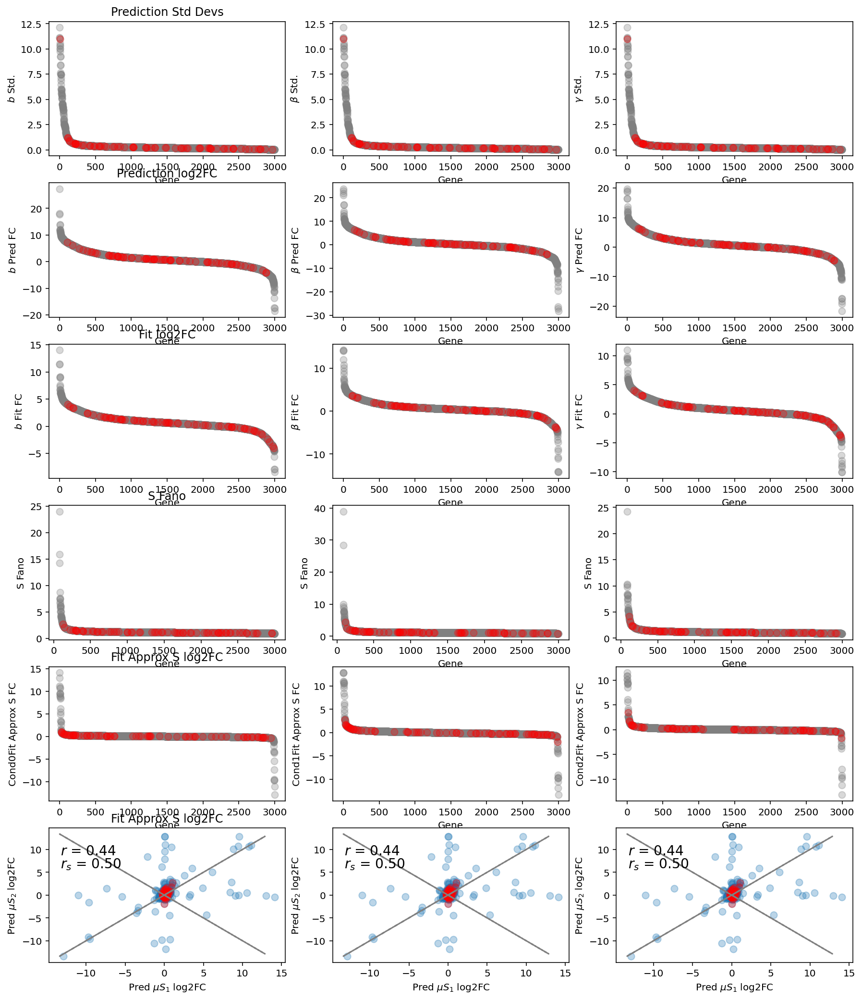

In [249]:
plotVars(par_vals,std_z,sd_arr,inds,forFilt,forFiltSub_top, xlab = 'Spliced', ylab='Parameter', figsize=(15,18),alpha=0.3,s=50,corr=True,fs=14 )



[[1.         0.85008492]
 [0.85008492 1.        ]]
0.7781685279156585


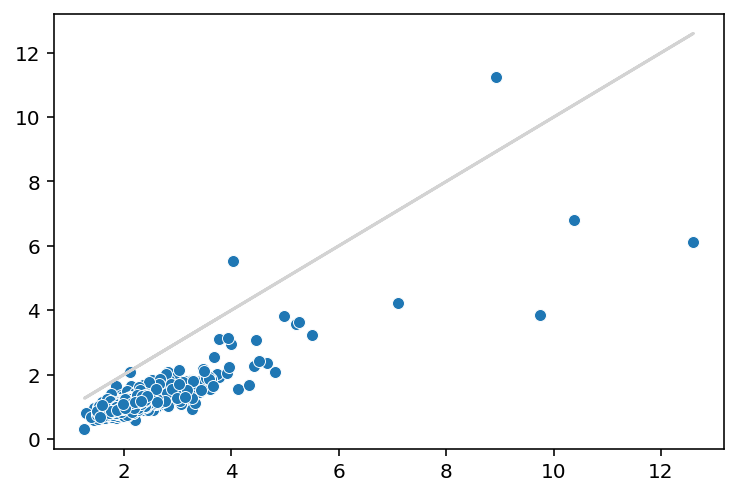

In [209]:
guess = np.mean(sd_arr[inds[0]].layers[1][forFilt,:],axis=1)/np.mean(sd_arr[inds[-1]].layers[1][forFilt,:],axis=1) + np.mean(sd_arr[inds[1]].layers[1][forFilt,:],axis=1)/np.mean(sd_arr[inds[-1]].layers[1][forFilt,:],axis=1)

true_vals = np.mean(sd_arr[inds[2]].layers[1][forFilt,:],axis=1)/np.mean(sd_arr[inds[-1]].layers[1][forFilt,:],axis=1)

sns.scatterplot(x=guess,y=true_vals)
plt.plot(guess,guess,color='lightgrey')
print(np.corrcoef(guess,true_vals))
print(scipy.stats.spearmanr(guess,true_vals)[0])

[[1.         0.84383476]
 [0.84383476 1.        ]]
0.7767382957250719


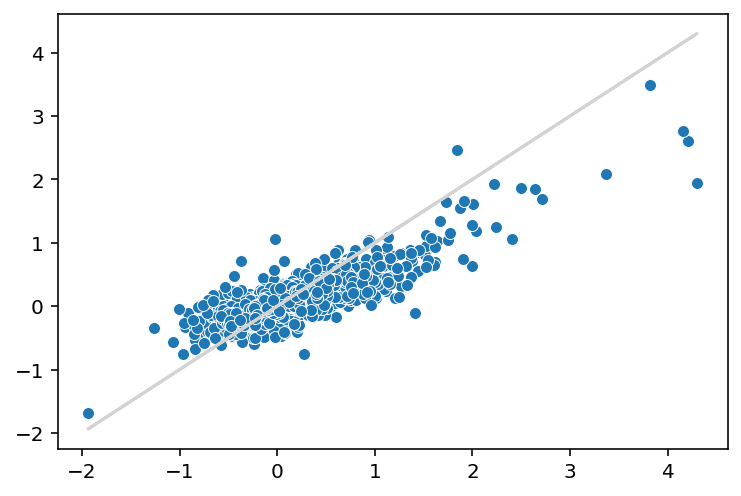

In [210]:
guess = np.log2(np.mean(sd_arr[inds[0]].layers[1][forFilt,:],axis=1)/np.mean(sd_arr[inds[-1]].layers[1][forFilt,:],axis=1))+np.log2(np.mean(sd_arr[inds[1]].layers[1][forFilt,:],axis=1)/np.mean(sd_arr[inds[-1]].layers[1][forFilt,:],axis=1))

true_vals = np.log2(np.mean(sd_arr[inds[2]].layers[1][forFilt,:],axis=1)/np.mean(sd_arr[inds[-1]].layers[1][forFilt,:],axis=1))

sns.scatterplot(x=guess,y=true_vals)
plt.plot(guess,guess,color='lightgrey')

print(np.corrcoef(guess,true_vals))
print(scipy.stats.spearmanr(guess,true_vals)[0])

In [212]:
# plt.scatter(np.mean(sd_arr[inds[0]].layers[1][forFilt,:],axis=1)/np.mean(sd_arr[inds[-1]].layers[1][forFilt,:],axis=1),
#             np.mean(sd_arr[inds[2]].layers[1][forFilt,:],axis=1)/np.mean(sd_arr[inds[-1]].layers[1][forFilt,:],axis=1),)
# #plt.plot(np.mean(sd_arr[inds[2]].layers[1][forFilt,:],axis=1)/np.mean(sd_arr[inds[-1]].layers[1][forFilt,:],axis=1),
#          #np.mean(sd_arr[inds[2]].layers[1][forFilt,:],axis=1)/np.mean(sd_arr[inds[-1]].layers[1][forFilt,:],axis=1))


In [211]:
# plt.scatter(np.log2(np.mean(sd_arr[inds[0]].layers[1][forFilt,:],axis=1)/np.mean(sd_arr[inds[-1]].layers[1][forFilt,:],axis=1)),
#             true_vals,)

# #plt.plot(true_vals,true_vals)

In [214]:
# plt.scatter(np.log2(np.mean(sd_arr[inds[1]].layers[1][forFilt,:],axis=1)/np.mean(sd_arr[inds[-1]].layers[1][forFilt,:],axis=1)),
#             true_vals,)
